<a href="https://colab.research.google.com/github/alifamrim/final-project-TDPDM/blob/main/Wordcloud_for_Analysis_PDM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#WORDCLOUD ANALYSIS

In [ ]:
!pip install matplotlib

In [ ]:
!git clone https://github.com/alifamrim/final-project-TDPDM.git

Cloning into 'final-project-TDPDM'...
remote: Enumerating objects: 25, done.
remote: Counting objects: 100% (25/25), done.
remote: Compressing objects: 100% (24/24), done.
remote: Total 25 (delta 10), reused 0 (delta 0), pack-reused 0
Receiving objects: 100% (25/25), 768.13 KiB | 2.92 MiB/s, done.
Resolving deltas: 100% (10/10), done.


In [ ]:
%pwd

'/content'

In [ ]:
%cd final-project-TDPDM

/content/final-project-TDPDM


In [ ]:
%pwd

'/content/final-project-TDPDM'

In [ ]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from collections import Counter

In [ ]:
!ls

'Clustering PDM - en_9clusters.csv'	   en_comments_5_clusters_final_semiclean.csv
'Clustering PDM - en_comments_clean.csv'   en_comments_8_clusters_finalfix_semiclean.csv
'Clustering PDM - id_9clusters.csv'	   id_comments_6_clusters_finalfix_semiclean.csv
'Clustering PDM - id_comments_clean.csv'   id_comments_6_clusters__final_semiclean.csv
 comments_en.csv			   id_comments_6_clusters_semiclean.csv
 df_comments_id.csv			   README.md
 en_comments_4_clusters_semiclean.csv


Pilih File CSV

In [ ]:
# Assuming the CSV files are in the same directory as your Colab notebook
csv_files = ["en_comments_8_clusters_finalfix_semiclean.csv",
             "id_comments_6_clusters_finalfix_semiclean.csv"]

# Create a dictionary to store DataFrames
dataframes = {}

# Read each CSV file into a DataFrame
for csv_file in csv_files:
    file_path = f"/content/final-project-TDPDM/{csv_file}"  # Update the path accordingly
    df = pd.read_csv(file_path)
    dataframes[csv_file] = df

# Display the first few rows of each DataFrame
for csv_file, df in dataframes.items():
    print(f"DataFrame: {csv_file}")
    print(df.head())
    print("\n")


DataFrame: en_comments_8_clusters_finalfix_semiclean.csv
                                                text  \
0  aljazeera can take this rohingya people on the...   
1  indonesia has helped them alot before but look...   
2  as indian i agree to indonesian people these p...   
3  we would like to clarify that based on the rep...   
4  mereka adalah beban negara kamirakyat kami mas...   

                                           tokenized  \
0  ['aljazeera', 'take', 'people', 'studio', 'let...   
1  ['helped', 'alot', 'look', 'theyre', 'theyre',...   
2  ['indian', 'agree', 'indonesian', 'people', 'p...   
3  ['would', 'like', 'clarify', 'based', 'republi...   
4  ['beban', 'negara', 'kamirakyat', 'kelaparan',...   

                                       tokenized_str  cluster  
0   aljazeera take people studio let stay weak tired        4  
1  helped alot look theyre theyre invading us cam...        5  
2  indian agree indonesian people people come set...        4  
3  would like

Generating word clouds for en_comments_8_clusters_finalfix_semiclean.csv...


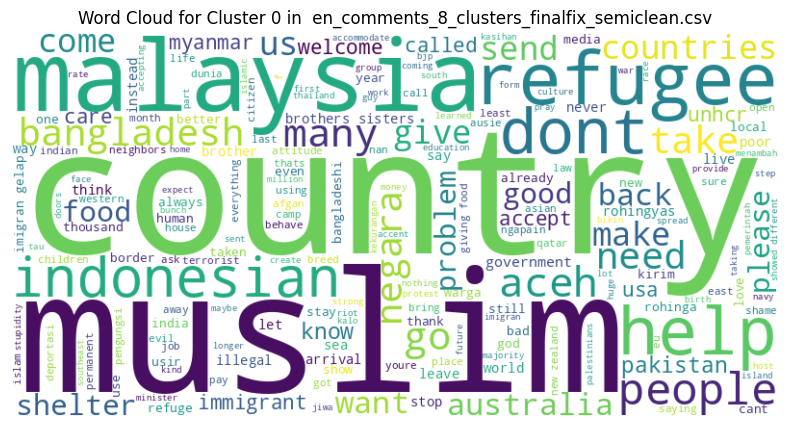

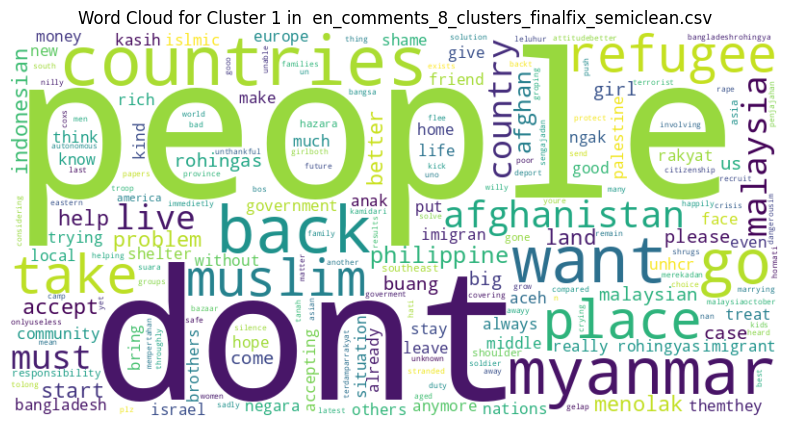

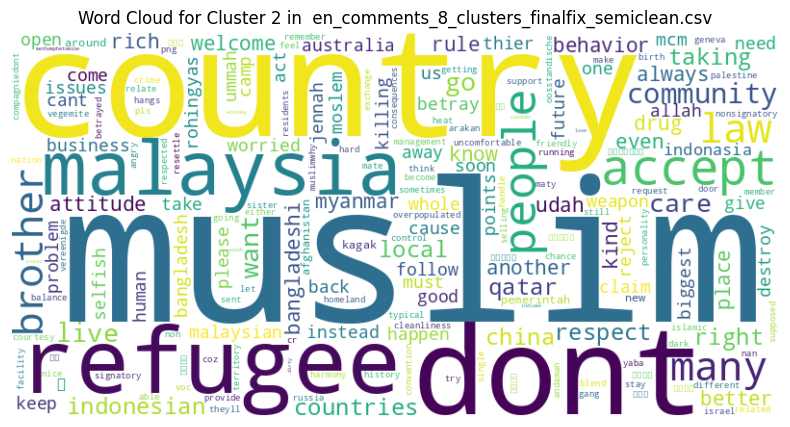

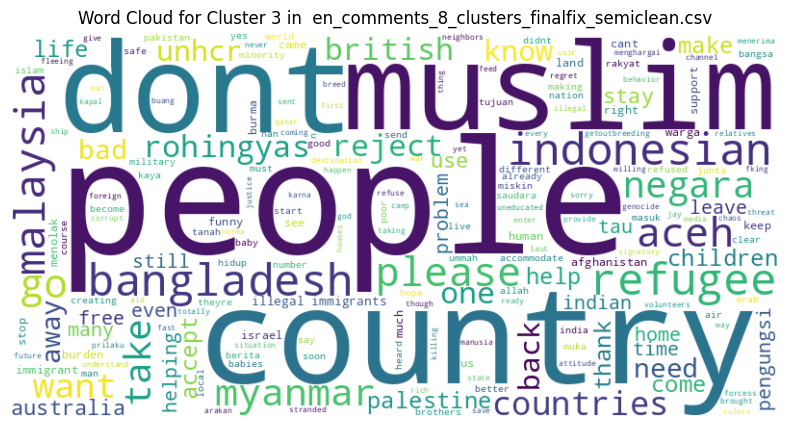

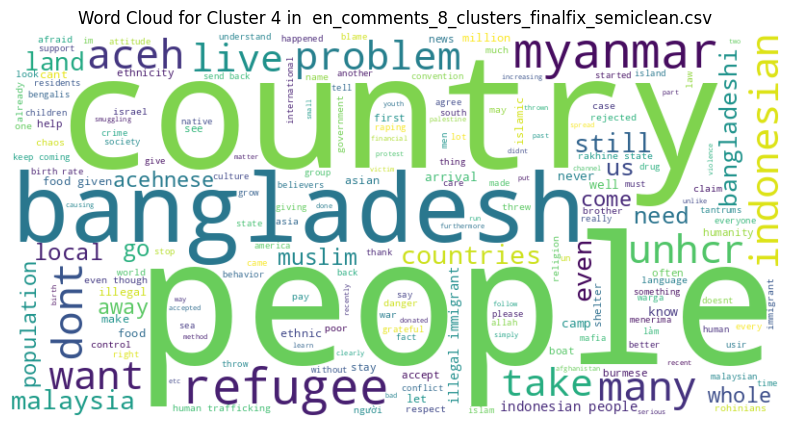

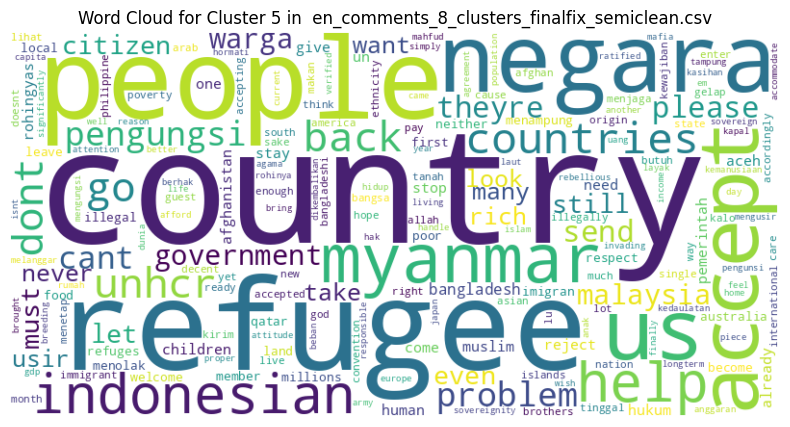

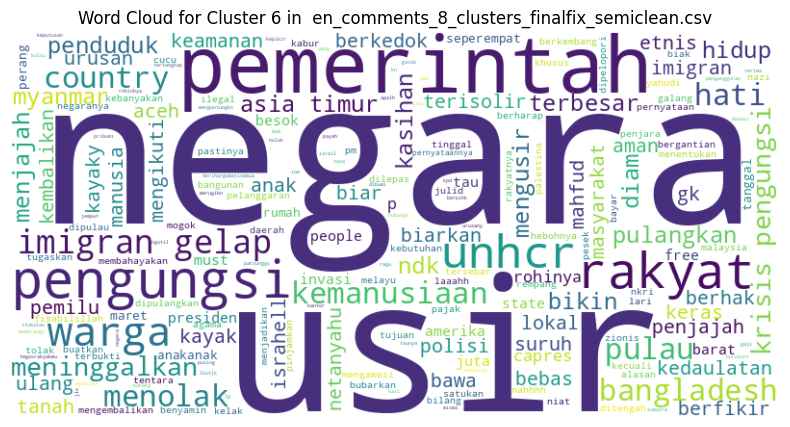

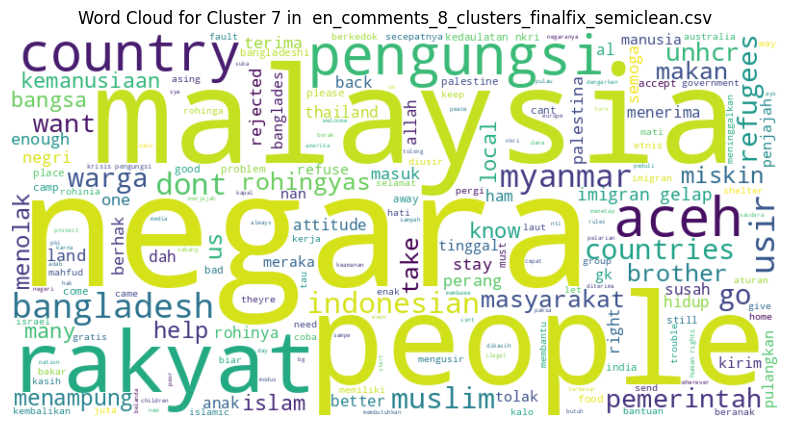

Generating word clouds for id_comments_6_clusters_finalfix_semiclean.csv...


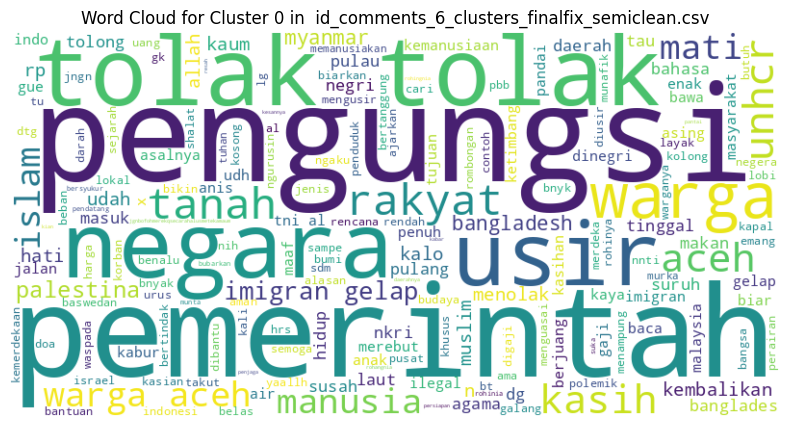

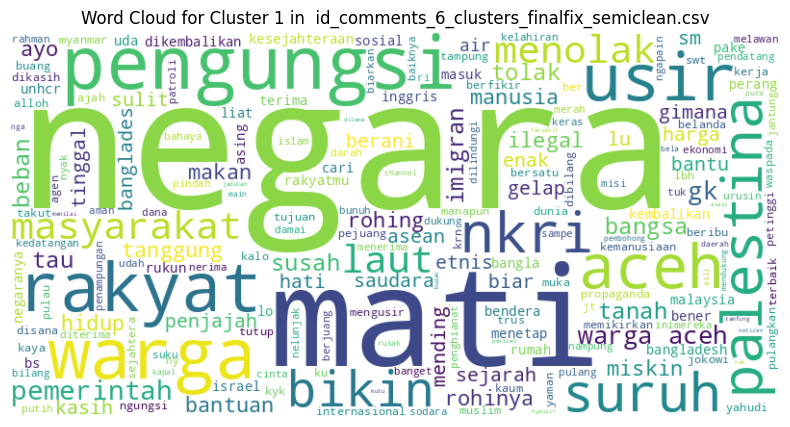

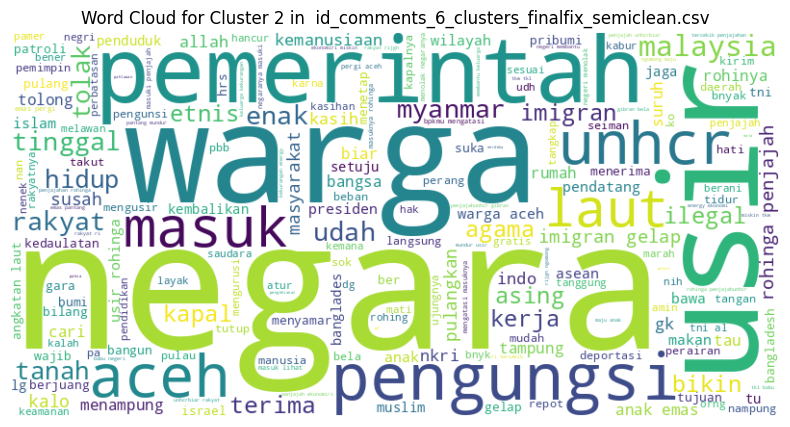

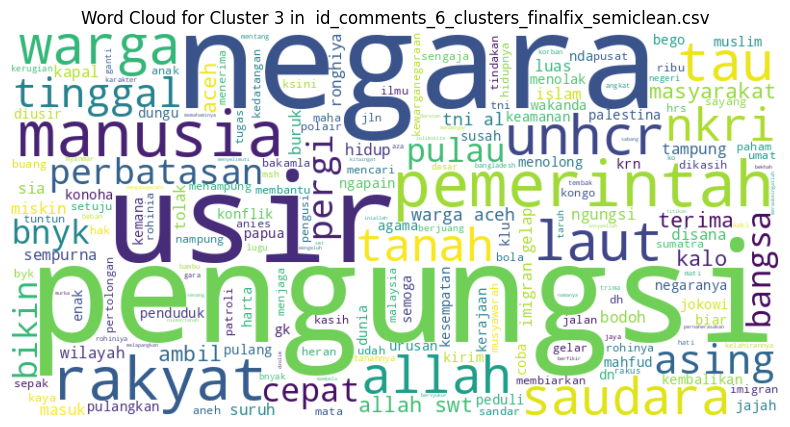

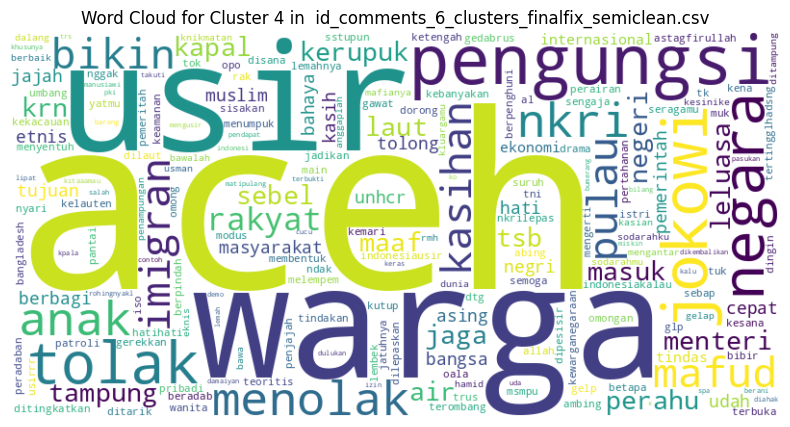

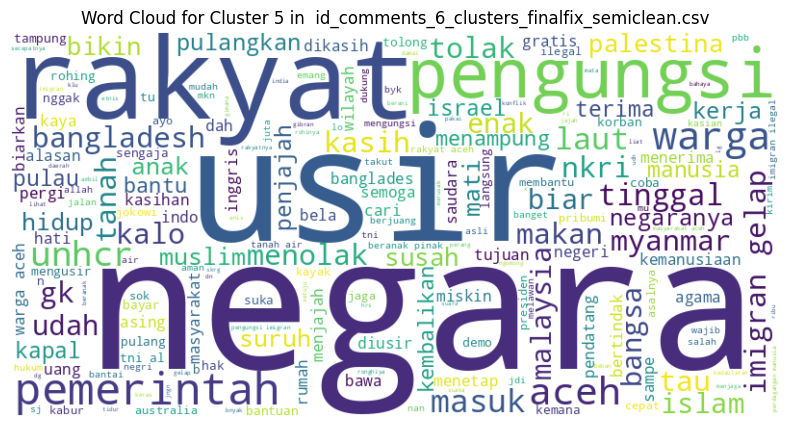

In [ ]:
# Assuming you have already loaded the CSV files into dataframes
# dataframes is the dictionary containing your dataframes

# Define a function to generate word clouds for each cluster
def generate_wordcloud(df):
    # Convert the 'text' column to strings
    df['tokenized_str'] = df['tokenized_str'].astype(str)

    # Group the DataFrame by the cluster column
    grouped = df.groupby('cluster')

    # Generate a word cloud for each cluster
    for cluster, group in grouped:
        text = ' '.join(group['tokenized_str'])

        # Generate word cloud
        wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)

        # Plot the word cloud
        plt.figure(figsize=(10, 5))
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.axis('off')
        plt.title(f'Word Cloud for Cluster {cluster} in {csv_file}')
        plt.show()

# Generate word clouds for each CSV file
for csv_file, df in dataframes.items():
    print(f"Generating word clouds for {csv_file}...")
    generate_wordcloud(df)

##Barchart

Generating top words bar chart for en_comments_8_clusters_finalfix_semiclean.csv...


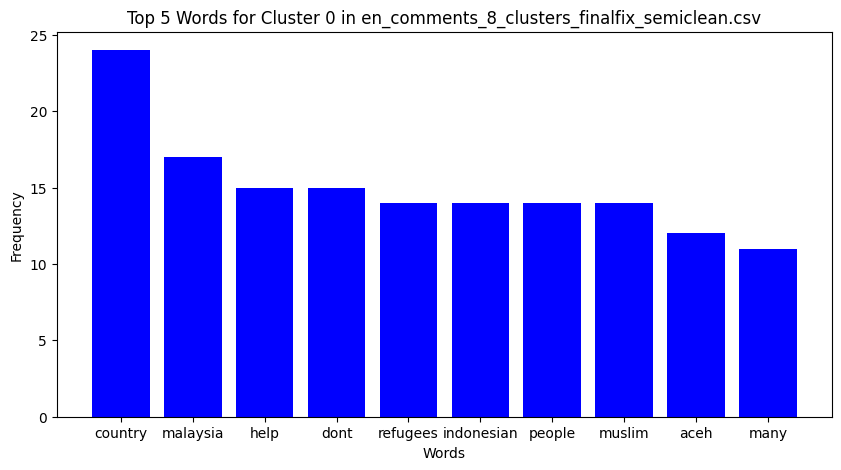

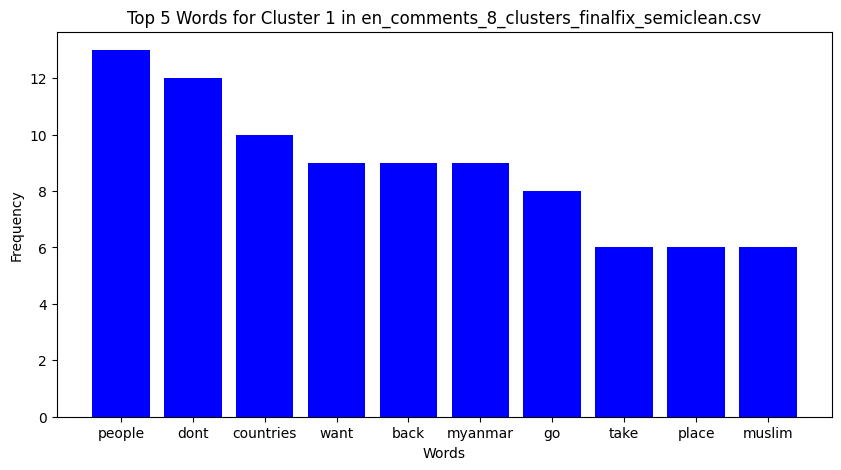

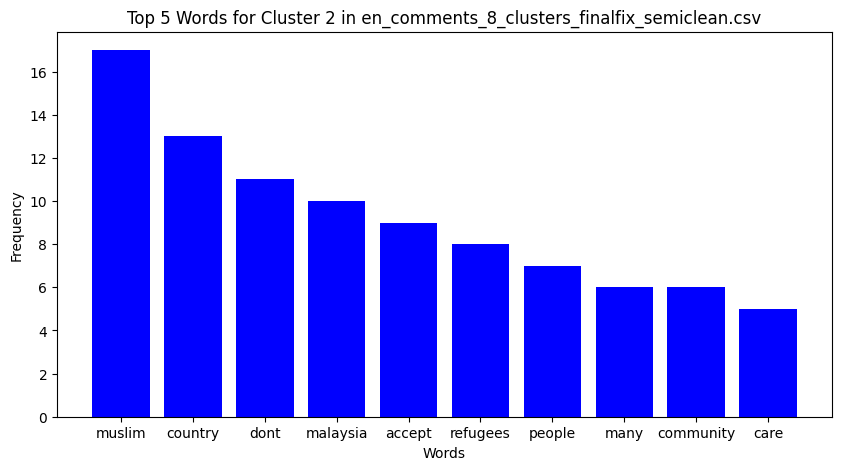

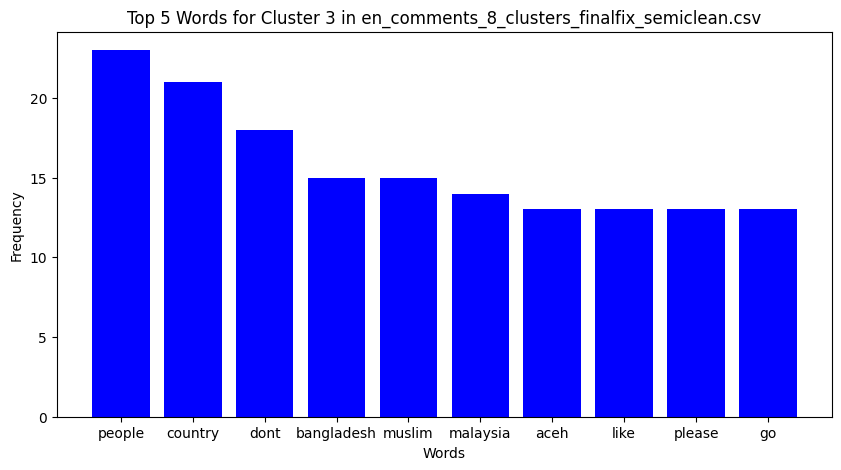

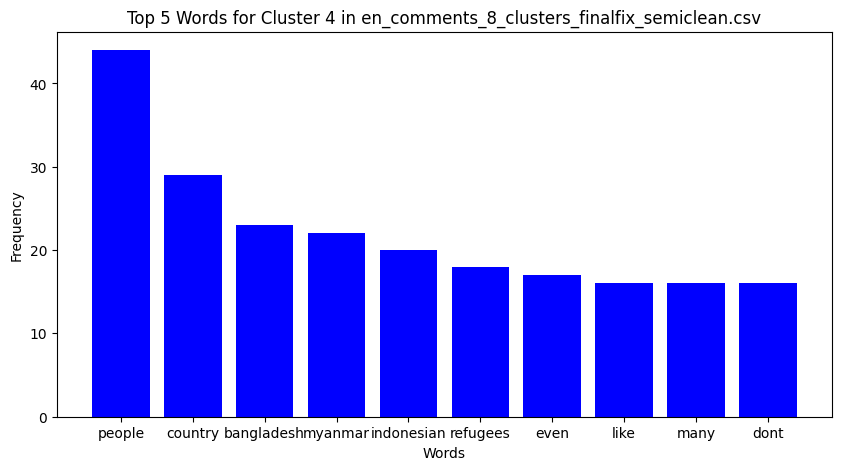

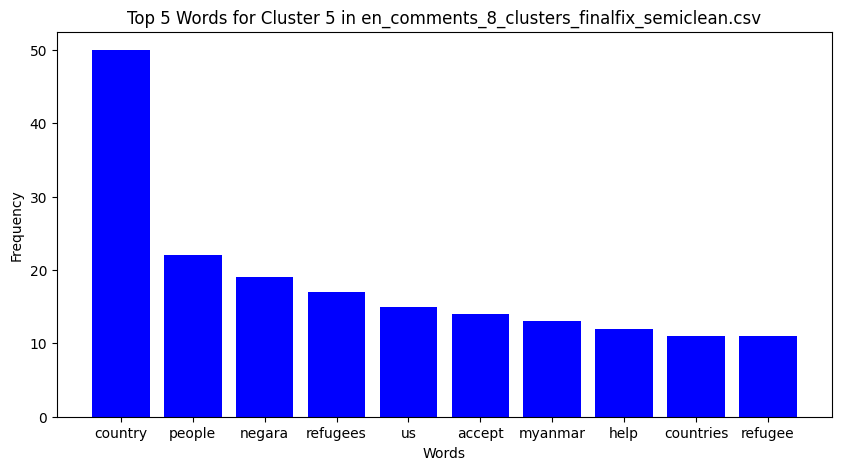

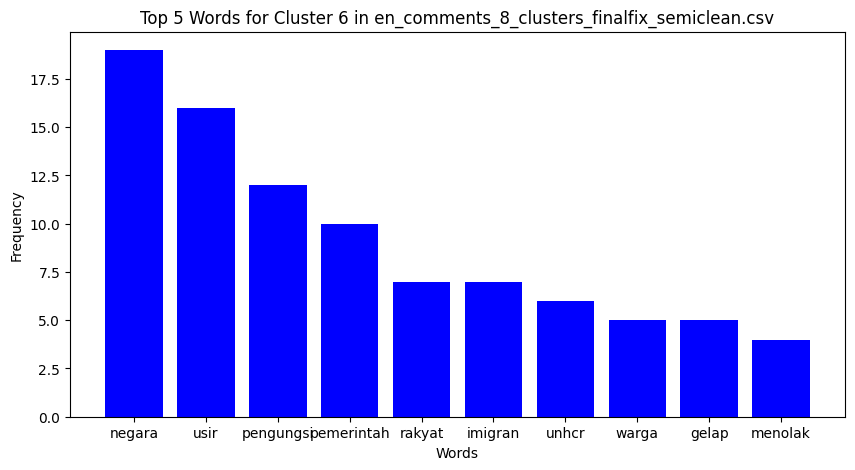

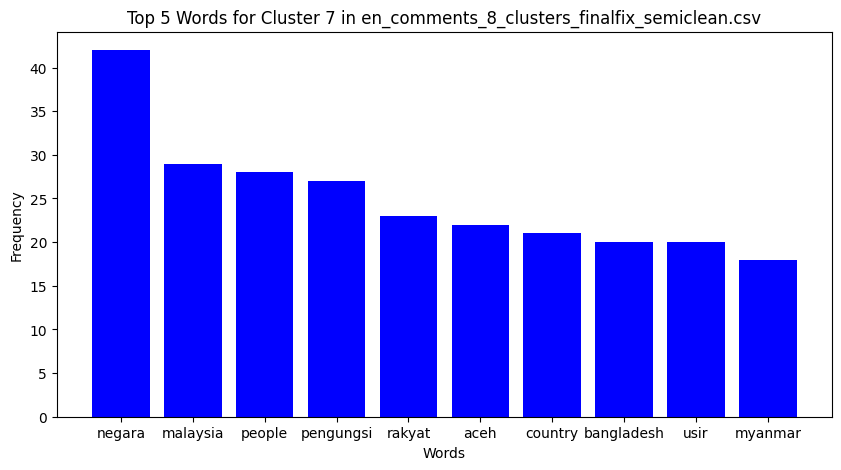

Generating top words bar chart for id_comments_6_clusters_finalfix_semiclean.csv...


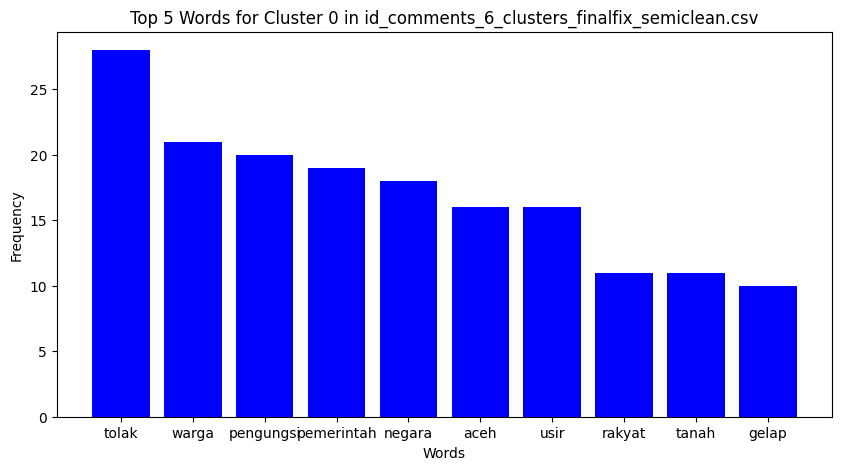

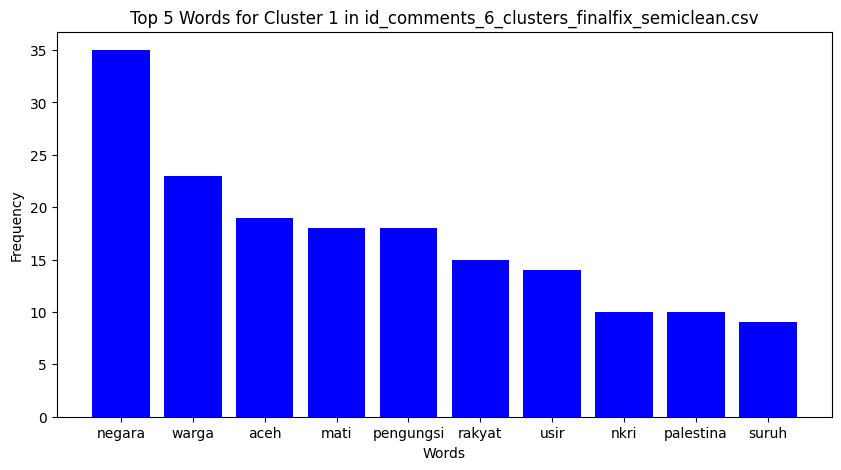

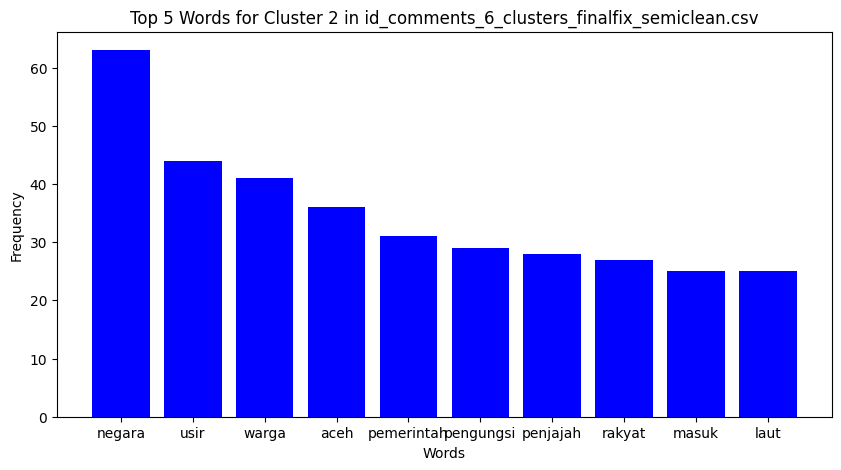

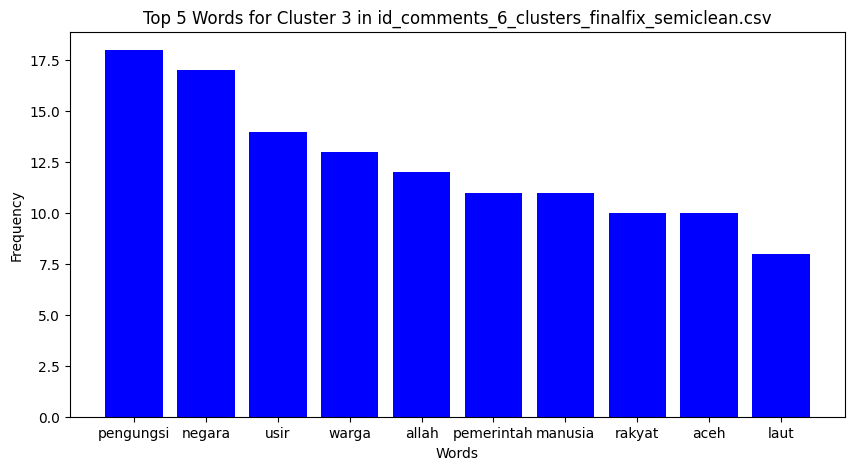

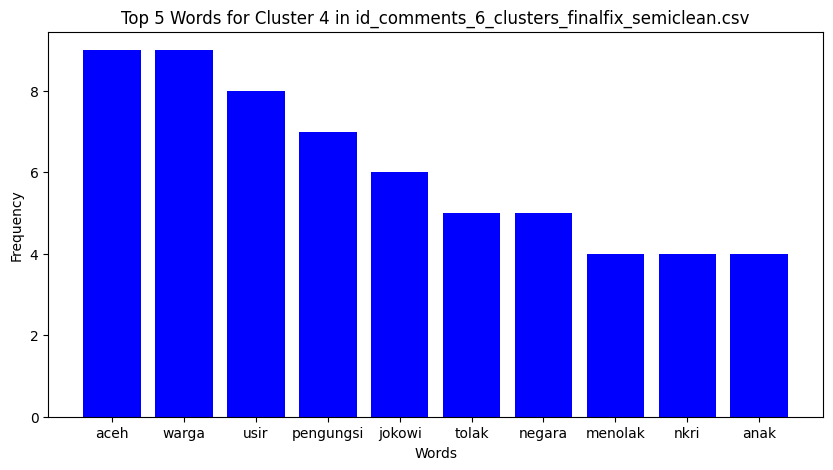

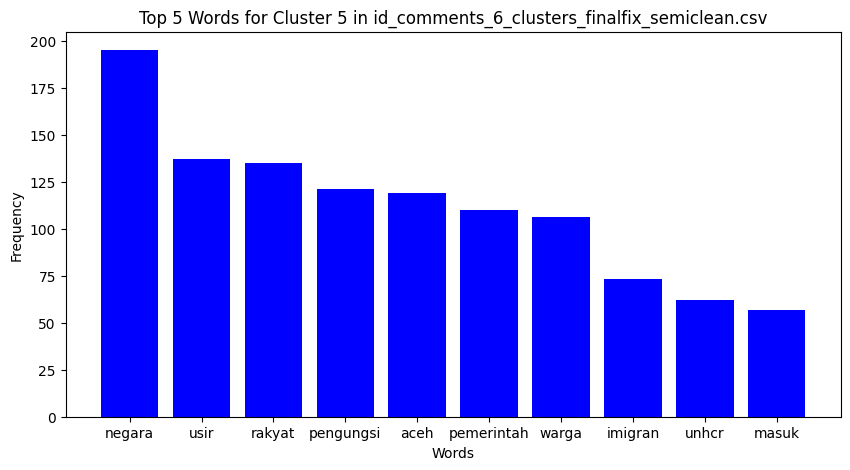

In [ ]:
# Assuming you have already loaded the CSV files into dataframes
# dataframes is the dictionary containing your dataframes

# Define a function to generate bar charts for top words in each cluster
def generate_top_words_bar_chart(df):
    # Convert the 'text' column to strings
    df['tokenized_str'] = df['tokenized_str'].astype(str)

    # Group the DataFrame by the cluster column
    grouped = df.groupby('cluster')

    # Generate a bar chart for each cluster
    for cluster, group in grouped:
        text = ' '.join(group['tokenized_str'])

        # Generate word cloud
        wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)

        # Count occurrences of words
        word_counts = Counter(text.split())

        # Get the top 5 words
        top_words = dict(word_counts.most_common(10))

        # Plot the bar chart
        plt.figure(figsize=(10, 5))
        plt.bar(top_words.keys(), top_words.values(), color='blue')
        plt.title(f'Top 5 Words for Cluster {cluster} in {csv_file}')
        plt.xlabel('Words')
        plt.ylabel('Frequency')
        plt.show()

# Generate bar charts for each CSV file
for csv_file, df in dataframes.items():
    print(f"Generating top words bar chart for {csv_file}...")
    generate_top_words_bar_chart(df)


cluster ada yang kelewatan, ada yang lolos dari penghapusan stopword

**ABAIKAN YANG BAWAH**

#W/ Stopword Removal + Custom Stopwords

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


Generating top words bar chart for Clustering PDM - en_9clusters.csv...


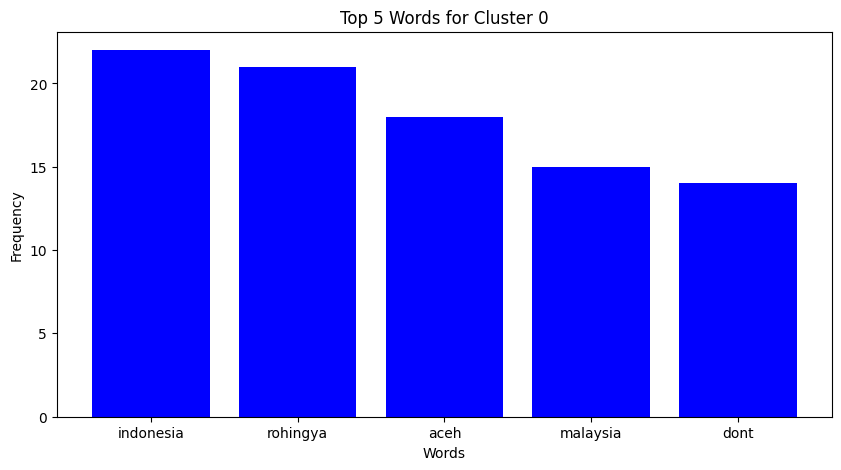

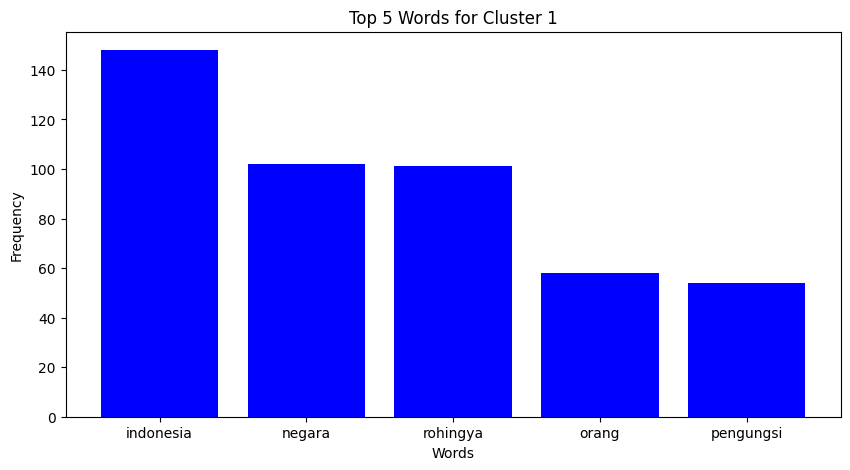

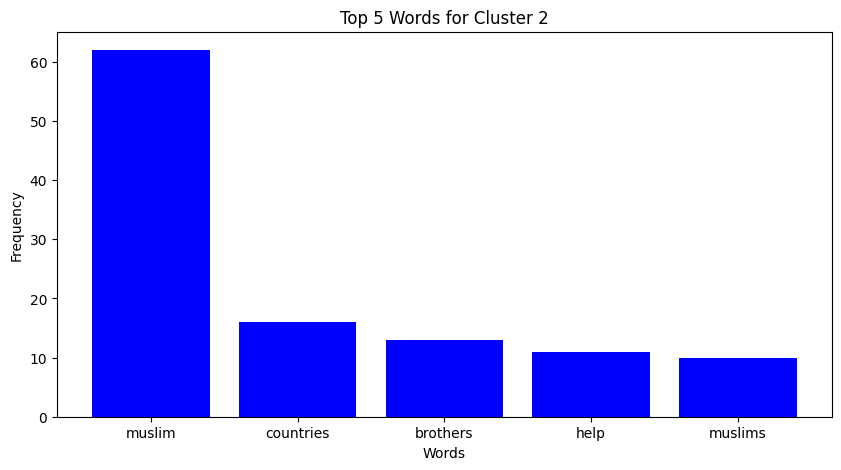

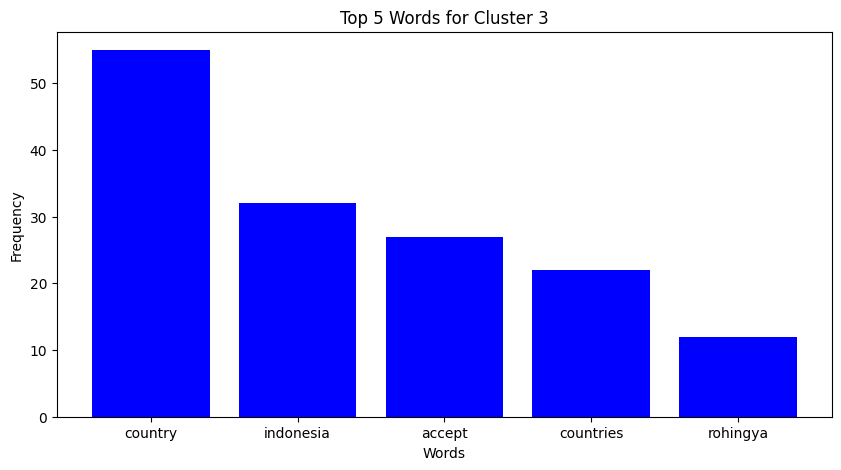

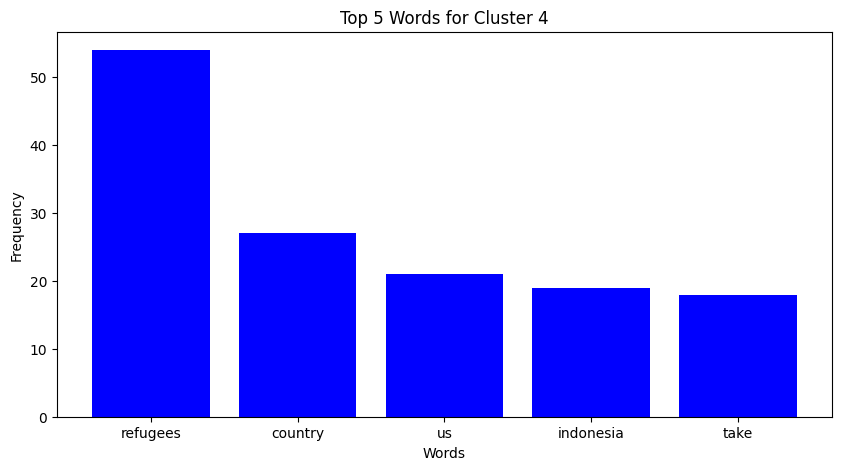

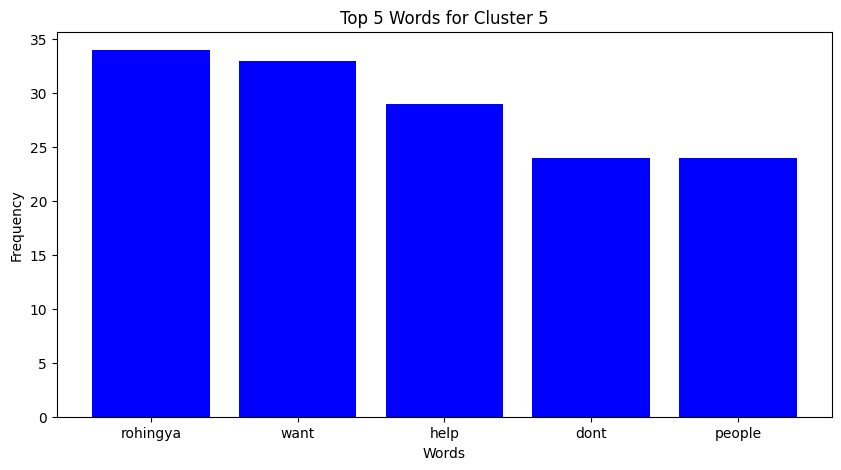

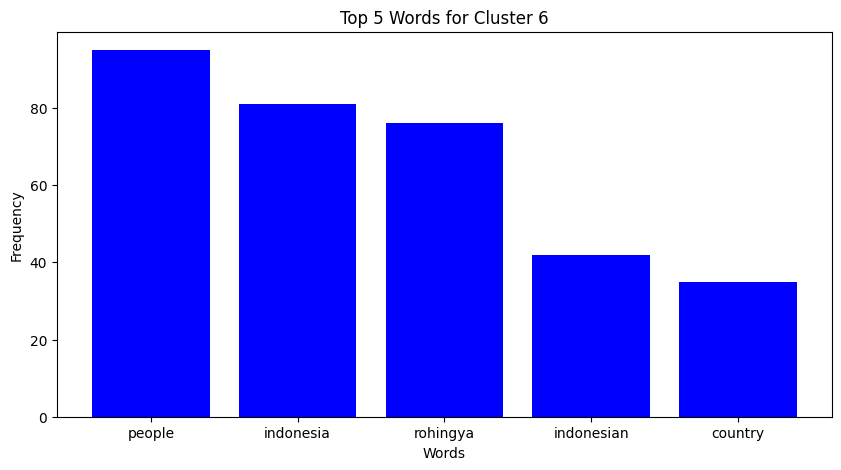

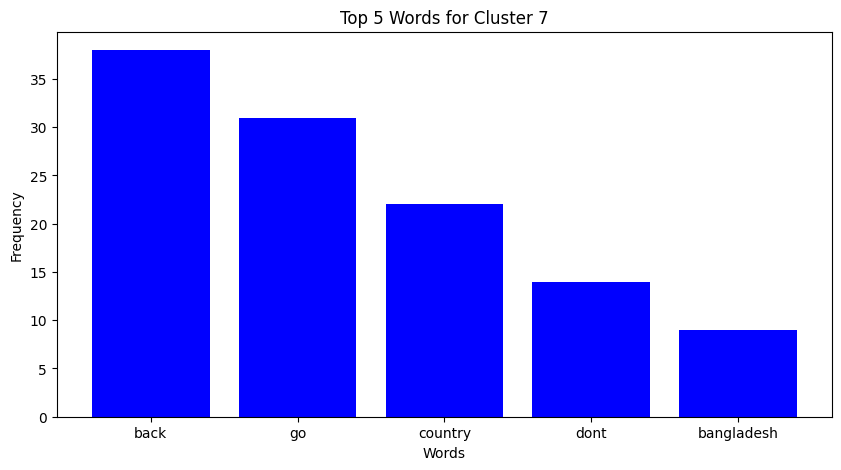

Generating top words bar chart for Clustering PDM - en_comments_clean.csv...


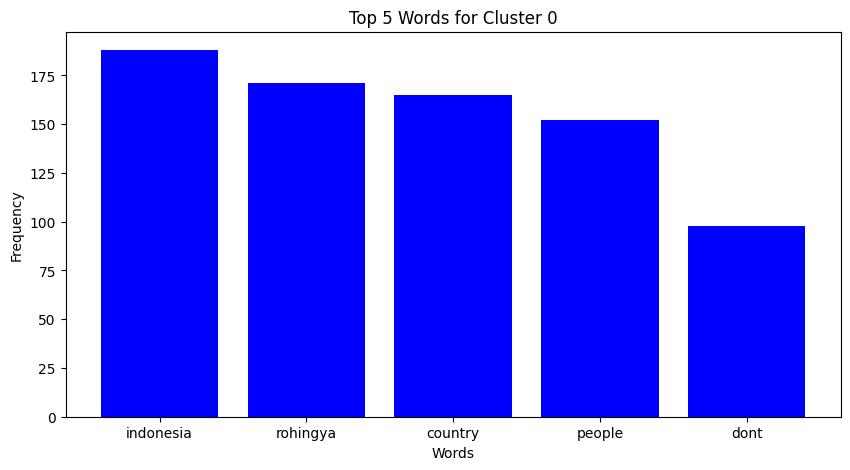

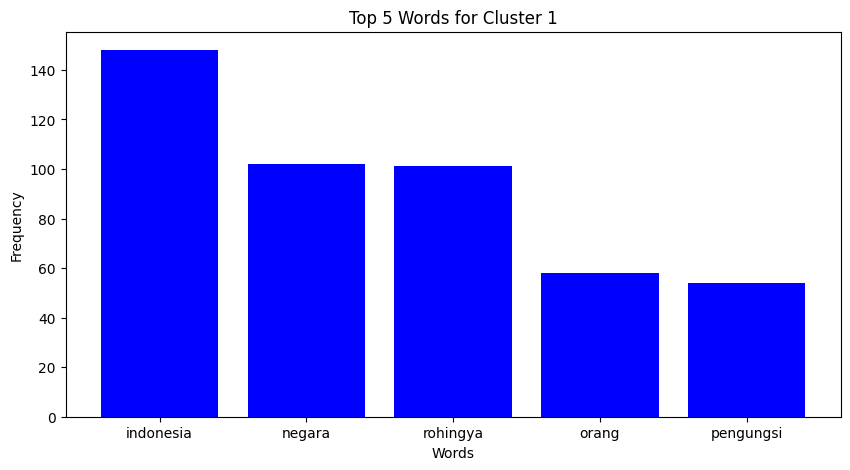

Generating top words bar chart for Clustering PDM - id_9clusters.csv...


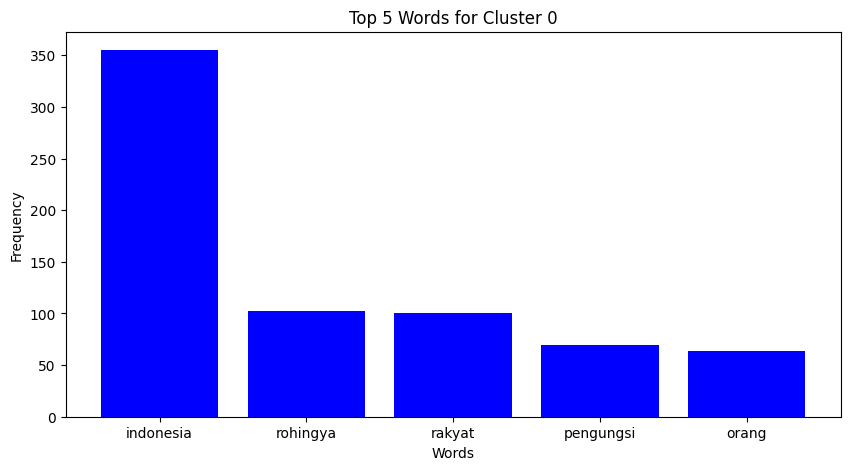

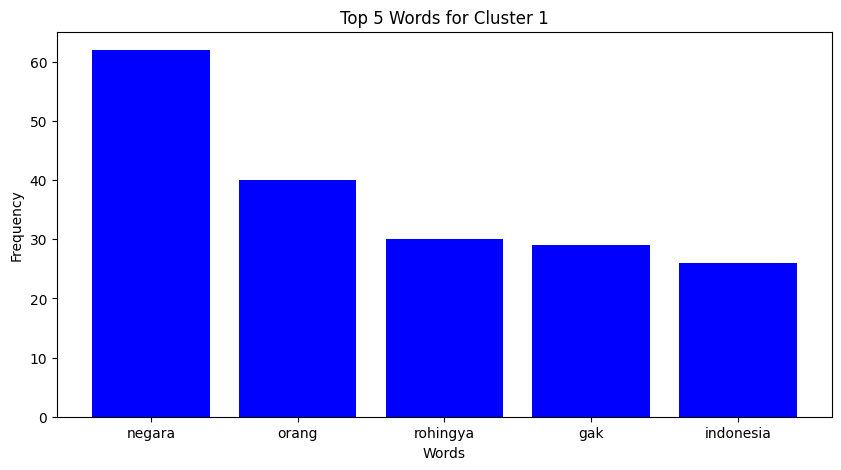

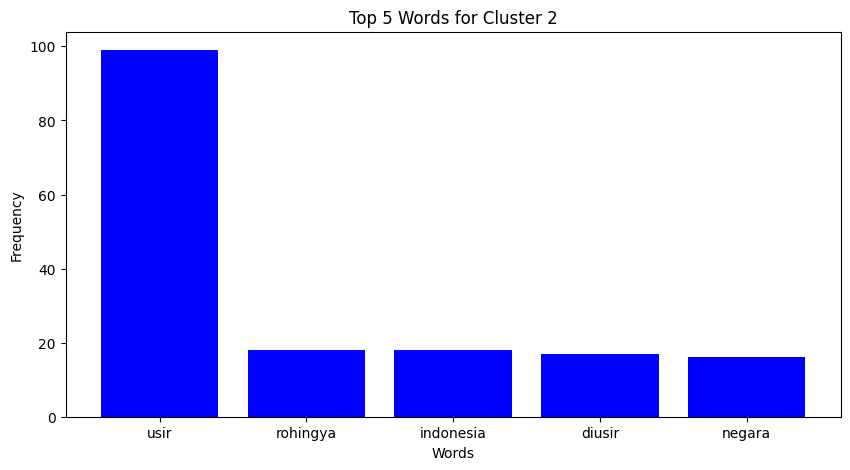

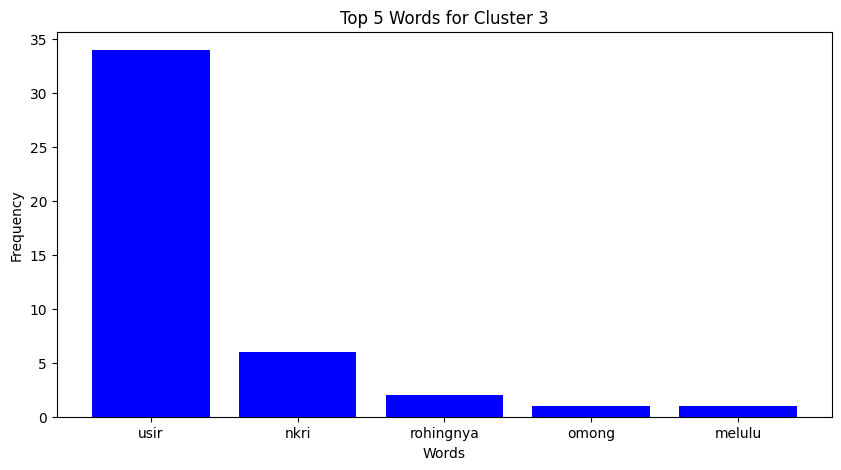

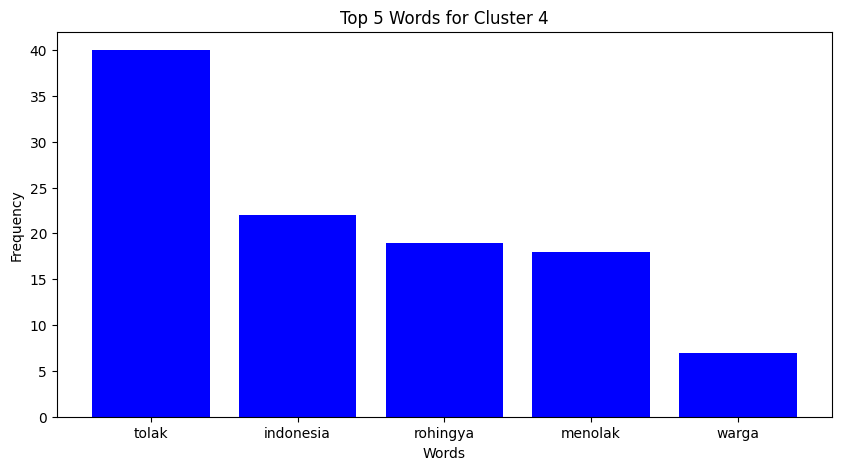

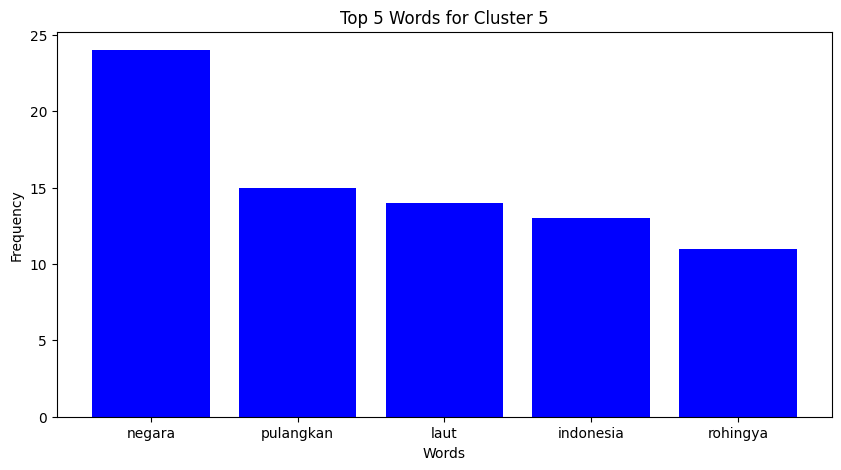

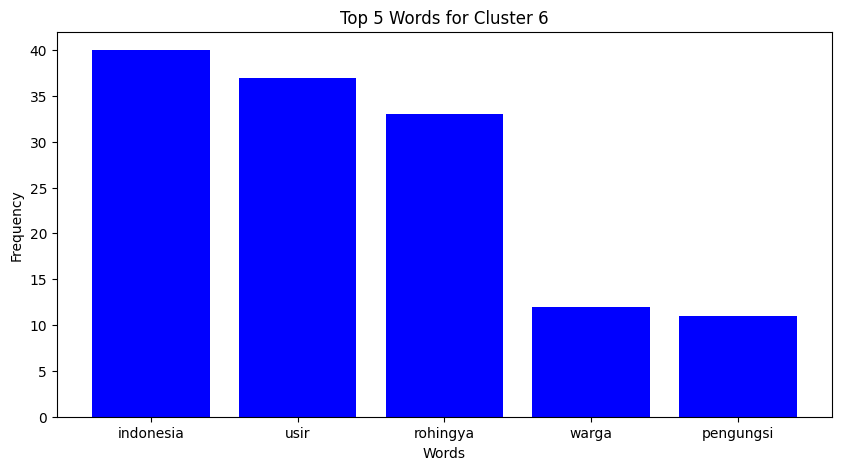

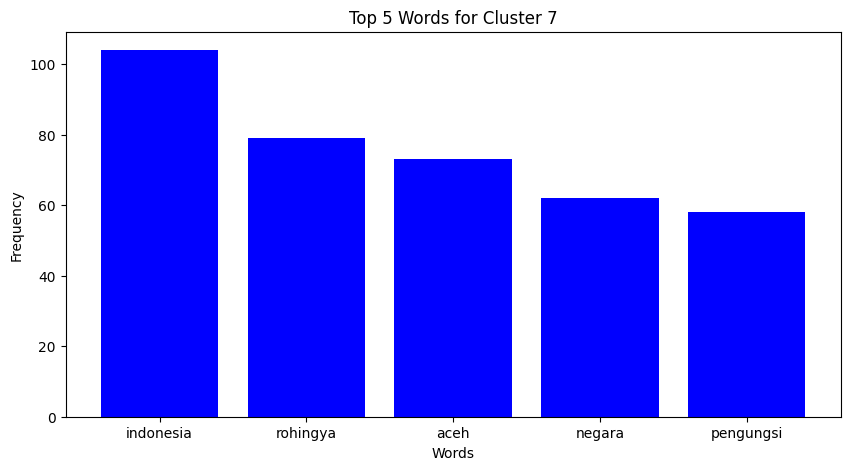

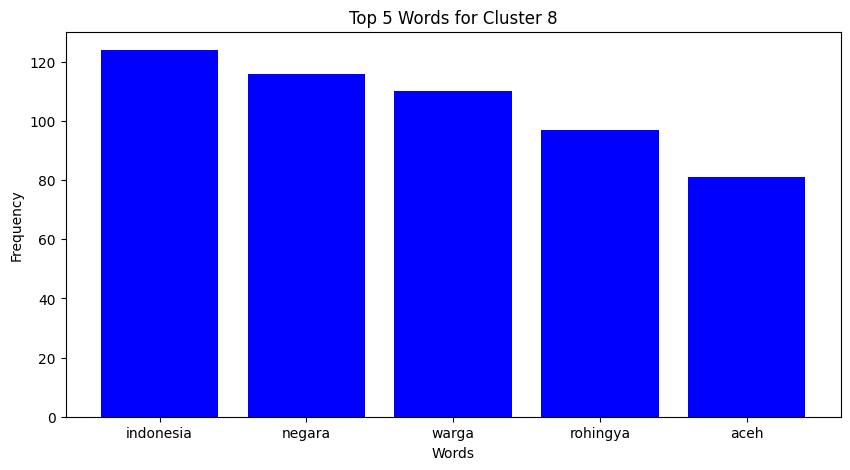

Generating top words bar chart for Clustering PDM - id_comments_clean.csv...


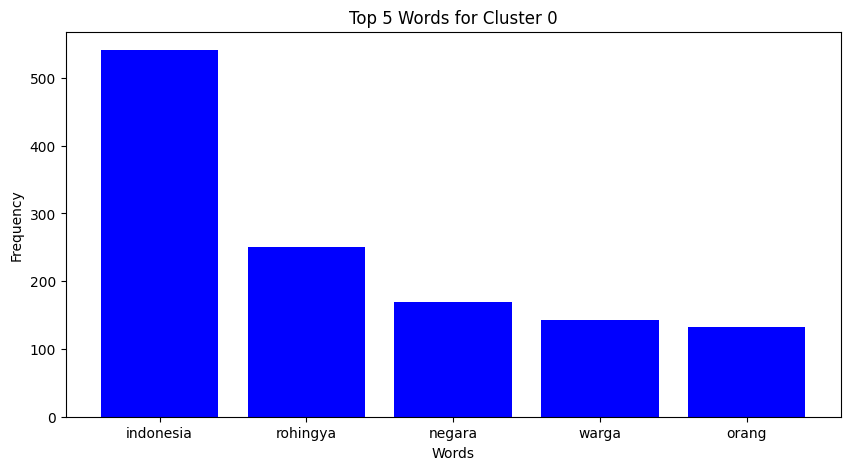

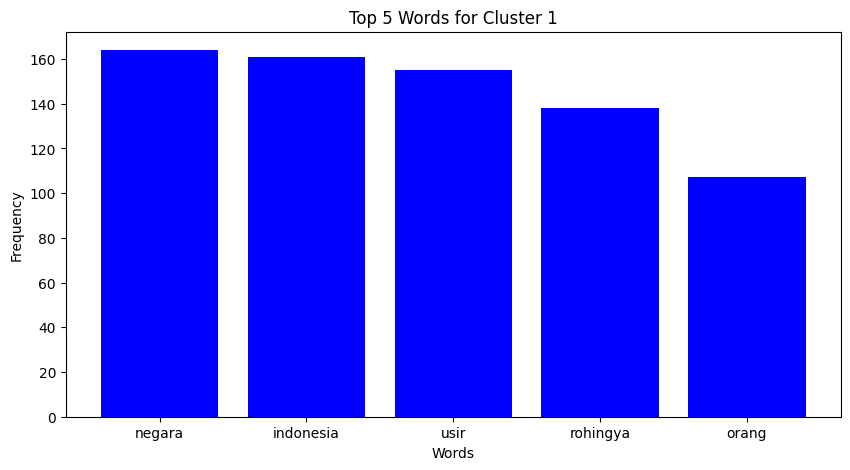

In [ ]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from collections import Counter
import nltk
from nltk.corpus import stopwords

# Download the stopwords corpora
nltk.download('stopwords')

# Assuming you have already loaded the CSV files into dataframes
# dataframes is the dictionary containing your dataframes

# Define a function to generate bar charts for top words in each cluster
def generate_top_words_bar_chart(df):
    # Convert the 'text' column to strings
    df['text'] = df['text'].astype(str)

    # Group the DataFrame by the cluster column
    grouped = df.groupby('cluster')

    # Load English and Bahasa (Indonesian) stopwords
    english_stop_words = set(stopwords.words('english'))
    indonesian_stop_words = set(stopwords.words('indonesian'))

    # Combine both English and Bahasa stopwords
    stop_words = english_stop_words.union(indonesian_stop_words)

    # Add custom stopwords
    custom_stopwords = ["yg", "nya", "aja"]  # Add your custom stopwords here
    stop_words.update(custom_stopwords)

    # Generate a bar chart for each cluster
    for cluster, group in grouped:
        text = ' '.join(group['text'])

        # Remove stopwords
        words = [word for word in text.split() if word.lower() not in stop_words]

        # Generate word cloud
        wordcloud = WordCloud(width=800, height=400, background_color='white').generate(' '.join(words))

        # Count occurrences of words
        word_counts = Counter(words)

        # Get the top 5 words
        top_words = dict(word_counts.most_common(5))

        # Plot the bar chart
        plt.figure(figsize=(10, 5))
        plt.bar(top_words.keys(), top_words.values(), color='blue')
        plt.title(f'Top 5 Words for Cluster {cluster}')
        plt.xlabel('Words')
        plt.ylabel('Frequency')
        plt.show()

# Generate bar charts for each CSV file
for csv_file, df in dataframes.items():
    print(f"Generating top words bar chart for {csv_file}...")
    generate_top_words_bar_chart(df)


#en_9clusters

In [ ]:
df = pd.read_csv(f'/content/final-project-TDPDM/Clustering PDM - en_9clusters.csv')
df

,text,cluster
0,aljazeera can take this rohingya people on the...,6
1,indonesia has helped them alot before br but l...,3
2,as indian i agree to indonesian people these p...,6
3,we would like to clarify that based on the rep...,6
4,mereka adalah beban negara kamibrrakyat kami m...,1
...,...,...
981,lord pls take care afghans national u are the ...,0
982,beware of immigrants see whats now going on in...,0
983,why we always seen as transit country simple w...,3
984,gausah nurut oz kasi kapal aja mreka ke oz rib...,1


Generating word clouds for Clustering PDM - en_9clusters.csv...


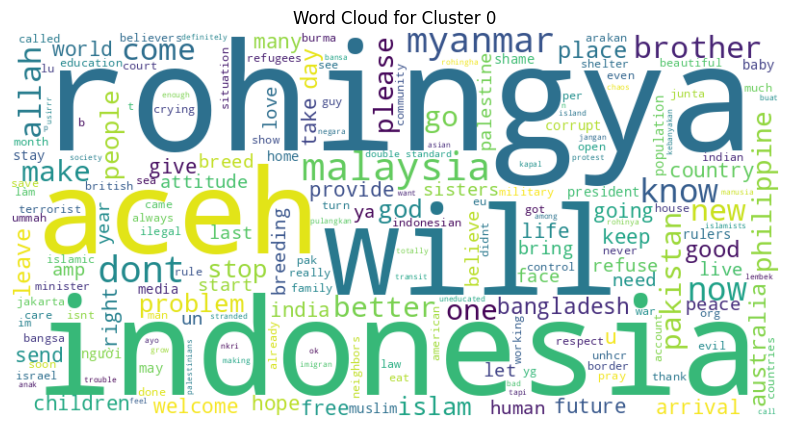

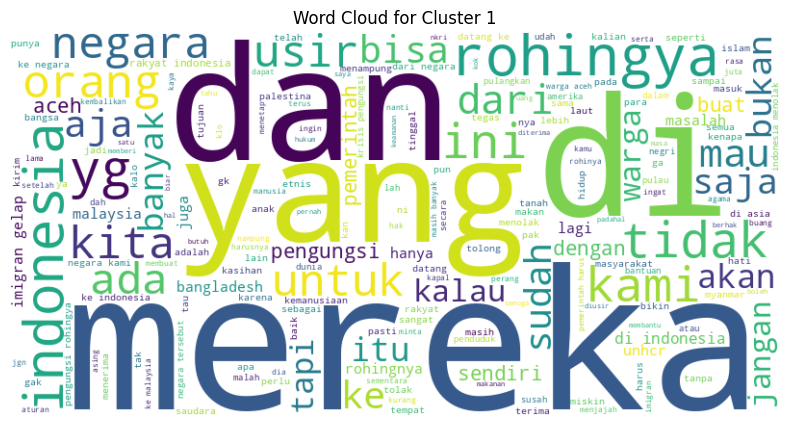

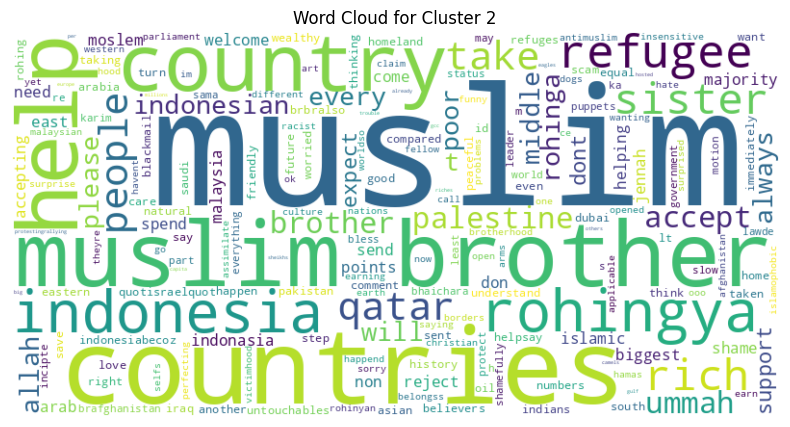

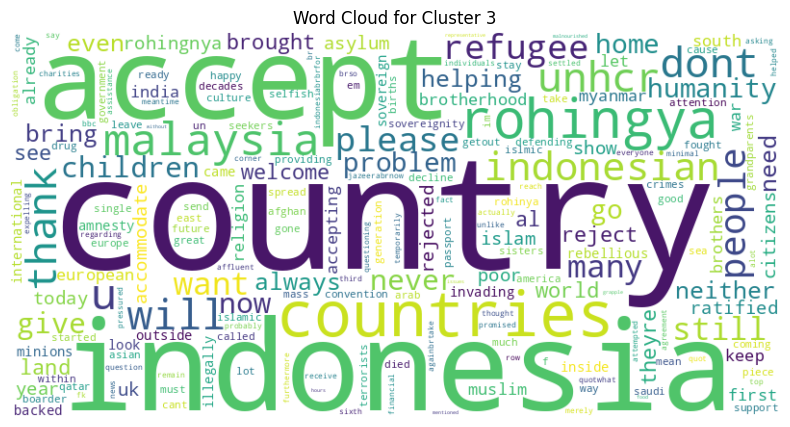

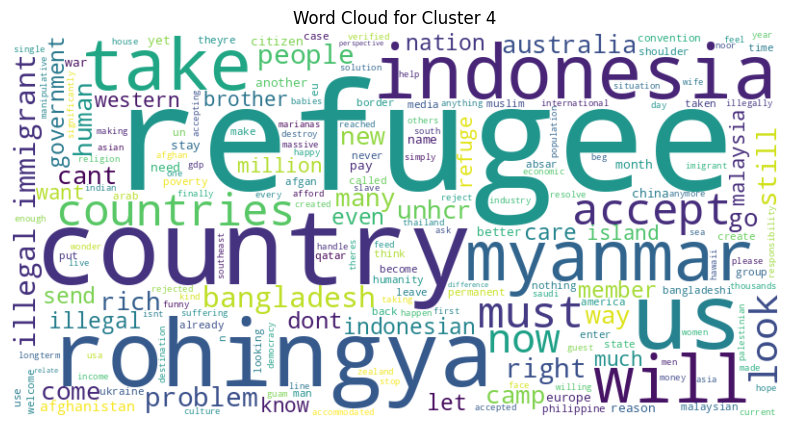

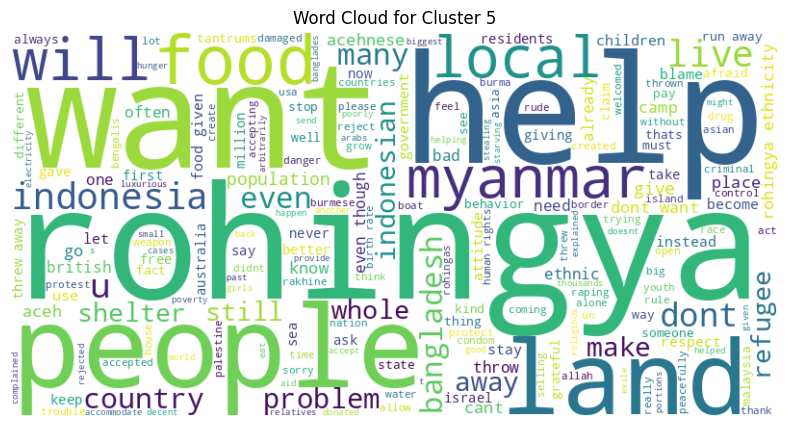

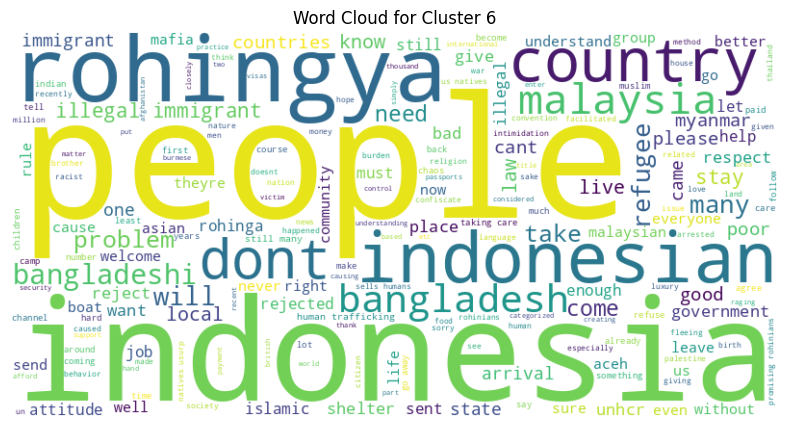

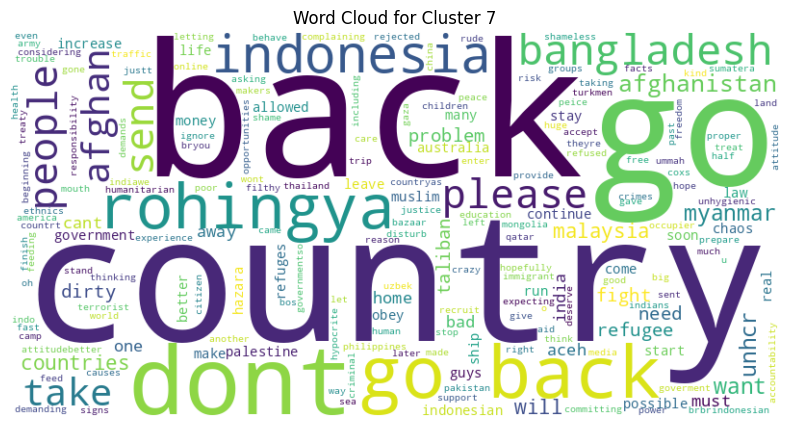

Generating word clouds for Clustering PDM - en_comments_clean.csv...


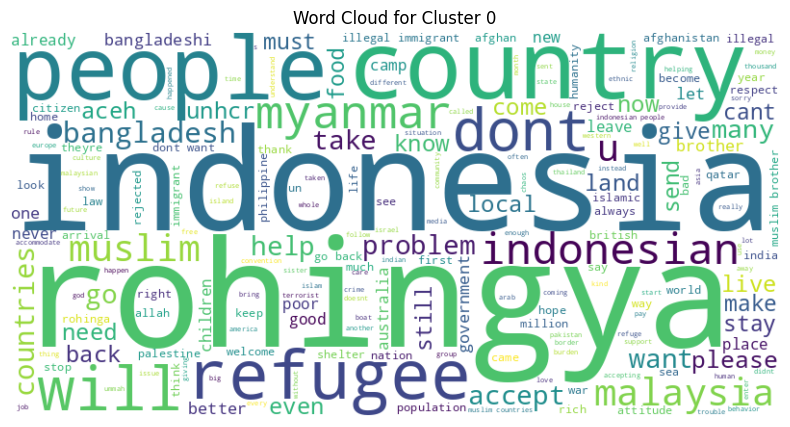

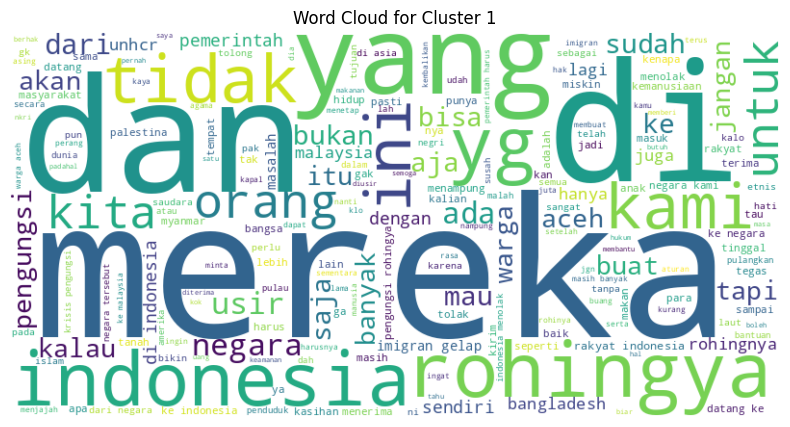

Generating word clouds for Clustering PDM - id_9clusters.csv...


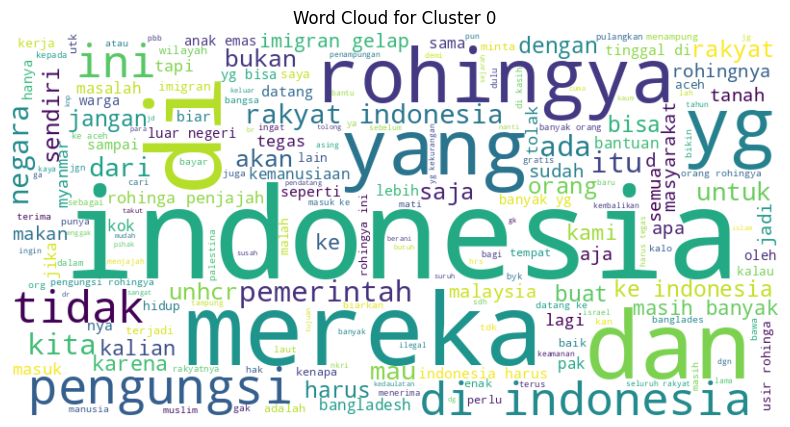

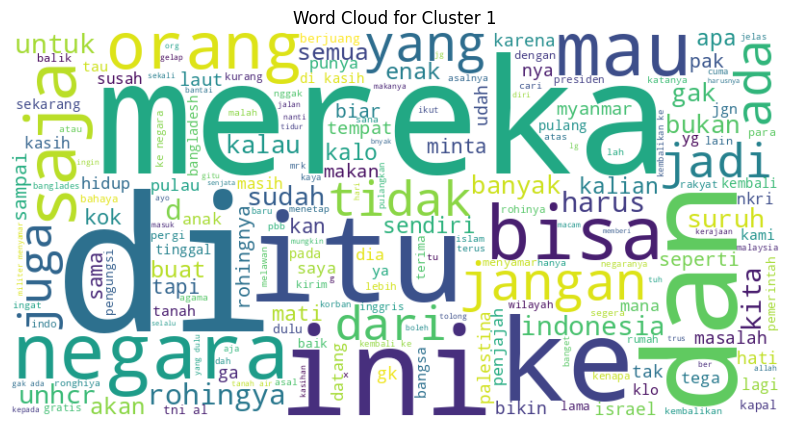

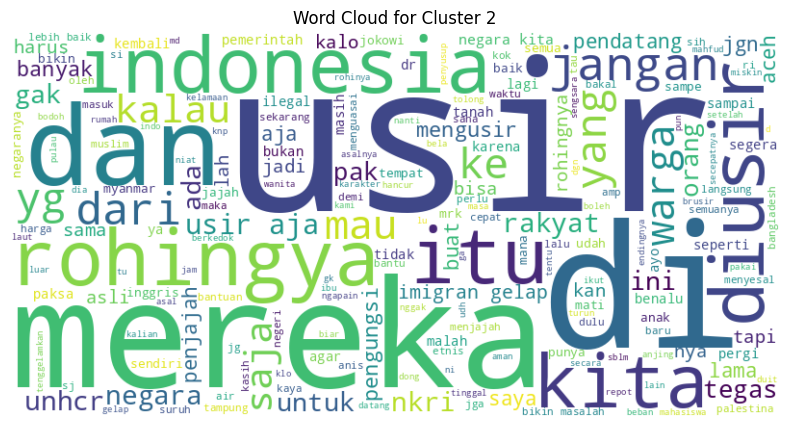

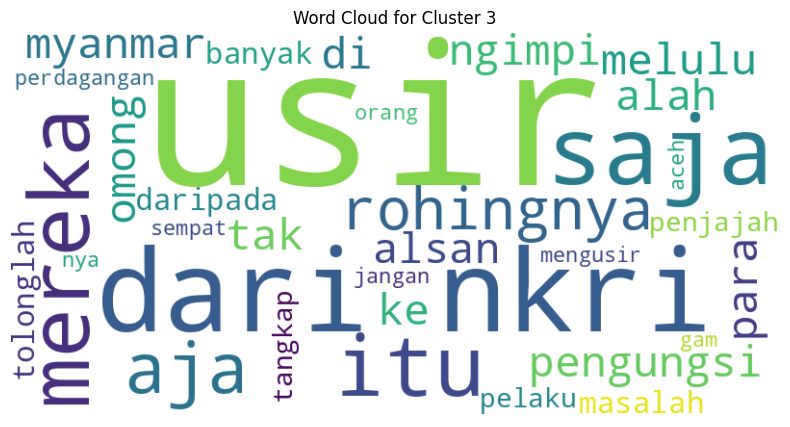

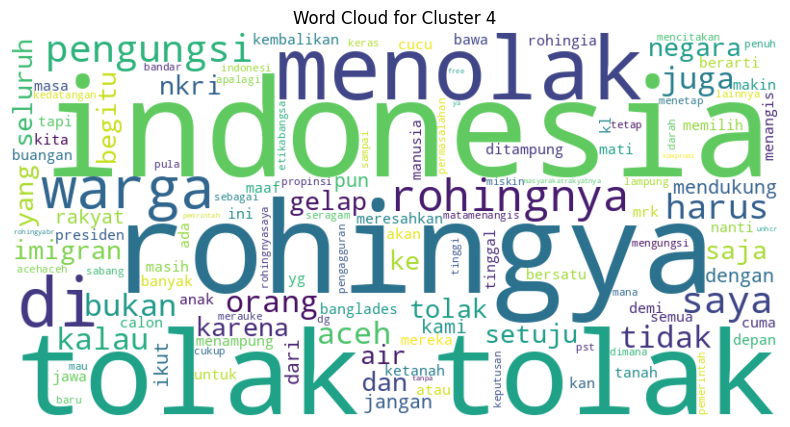

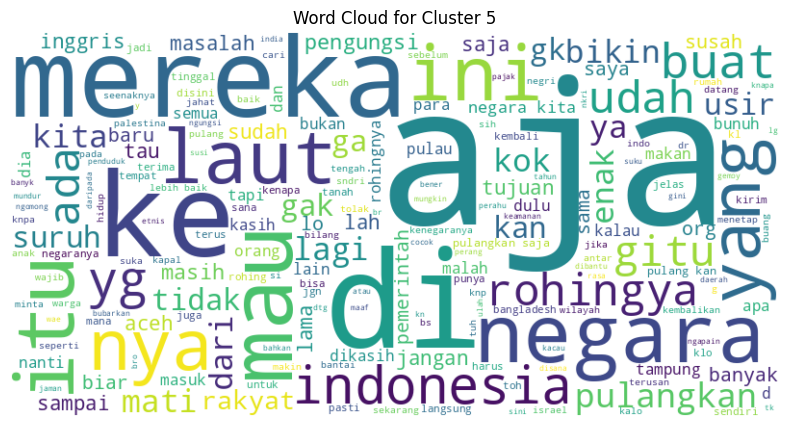

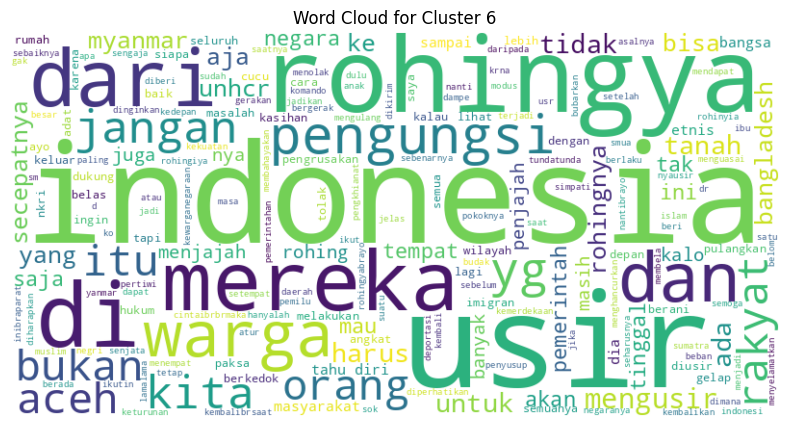

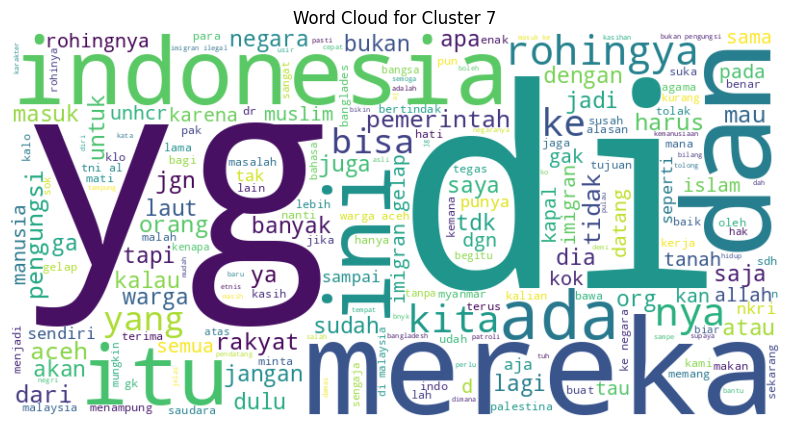

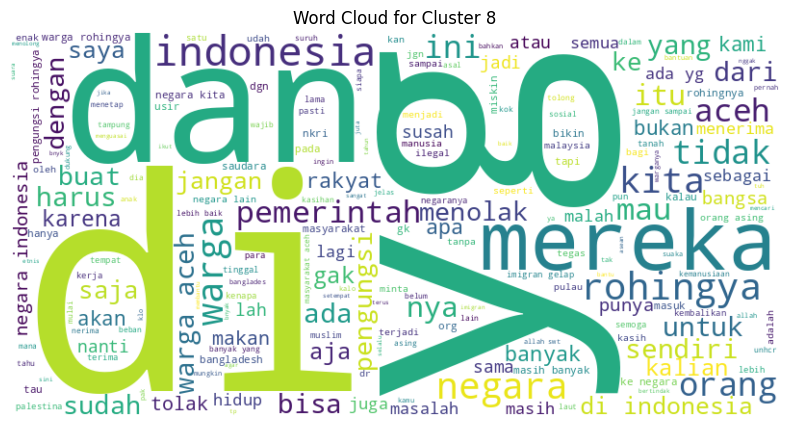

Generating word clouds for Clustering PDM - id_comments_clean.csv...


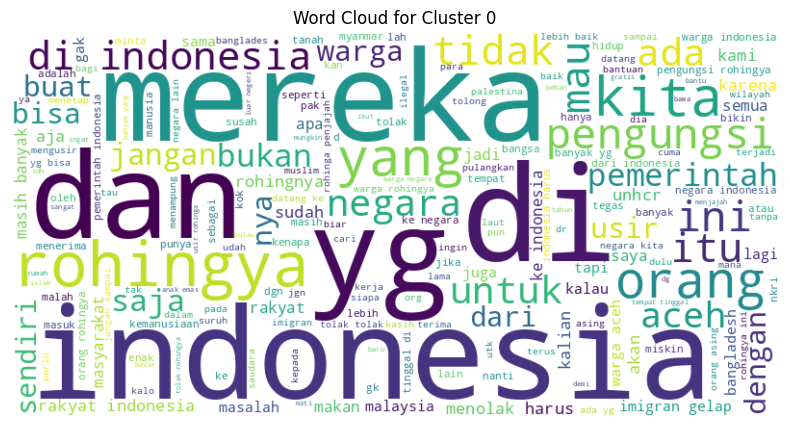

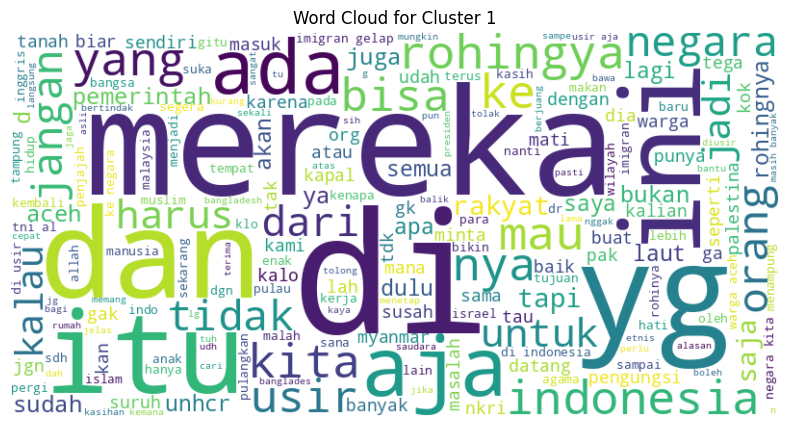

In [ ]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Assuming you have already loaded the CSV files into dataframes
# dataframes is the dictionary containing your dataframes

# Define a function to generate word clouds for each cluster
def generate_wordcloud(df):
    # Convert the 'text' column to strings
    df['text'] = df['text'].astype(str)

    # Group the DataFrame by the cluster column
    grouped = df.groupby('cluster')

    # Generate a word cloud for each cluster
    for cluster, group in grouped:
        text = ' '.join(group['text'])

        # Generate word cloud
        wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)

        # Plot the word cloud
        plt.figure(figsize=(10, 5))
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.axis('off')
        plt.title(f'Word Cloud for Cluster {cluster}')
        plt.show()

# Generate word clouds for each CSV file
for csv_file, df in dataframes.items():
    print(f"Generating word clouds for {csv_file}...")
    generate_wordcloud(df)


#en_comments_clean





#id_9clusters

In [ ]:
df = pd.read_csv(f'/content/final-project-TDPDM/Clustering PDM - id_9clusters.csv')
df

,text,cluster
0,budha myanmar teroris,1
1,apa pun itu sejarahnya kuta tidak bole menerim...,7
2,km umat islam carikan solusi rohingnya kl ngom...,5
3,org tdk tau brsukur,7
4,dilihat cara berpakaian sebagian mereka serba ...,7
...,...,...
1761,ditolak saja akal bulus mrk itu nanti klo udh ...,1
1762,lebih baik kembalikan saja ke asal sabab klau ...,7
1763,warga indonesia banyak yang gak bisa makan dan...,8
1764,rakyat indonesia sendiri masih jutaan yg kekur...,0


Generating word clouds for Clustering PDM - en_9clusters.csv...


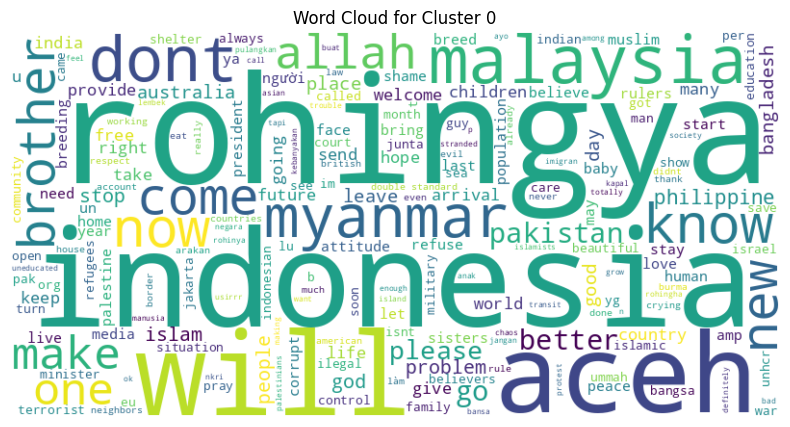

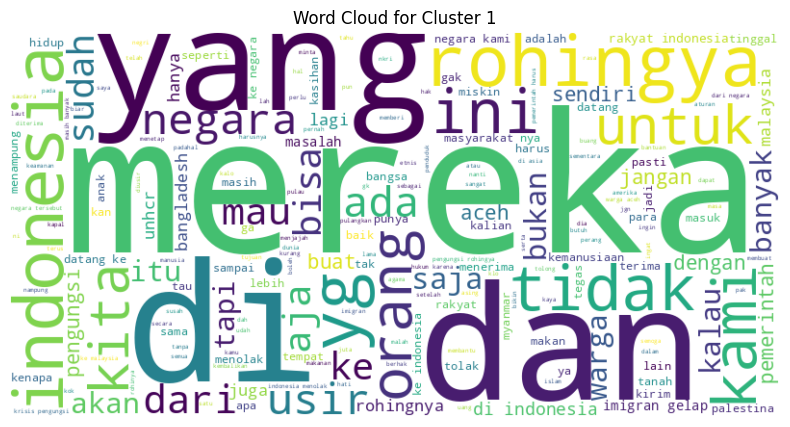

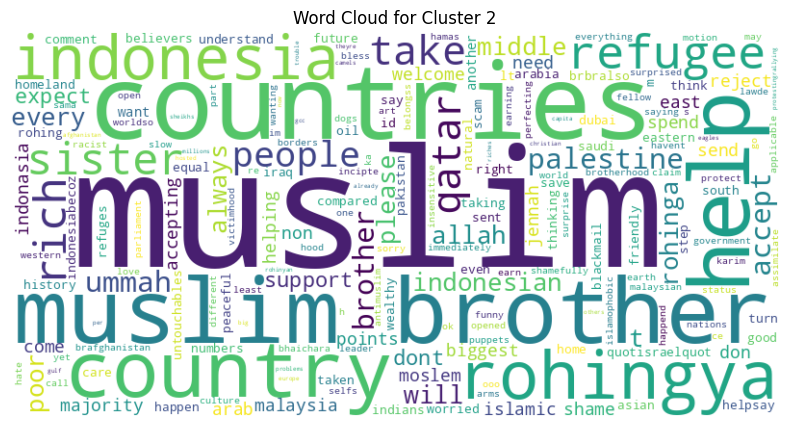

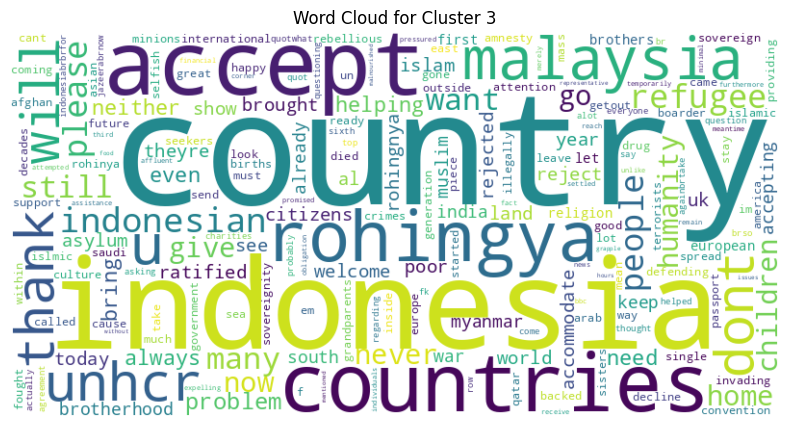

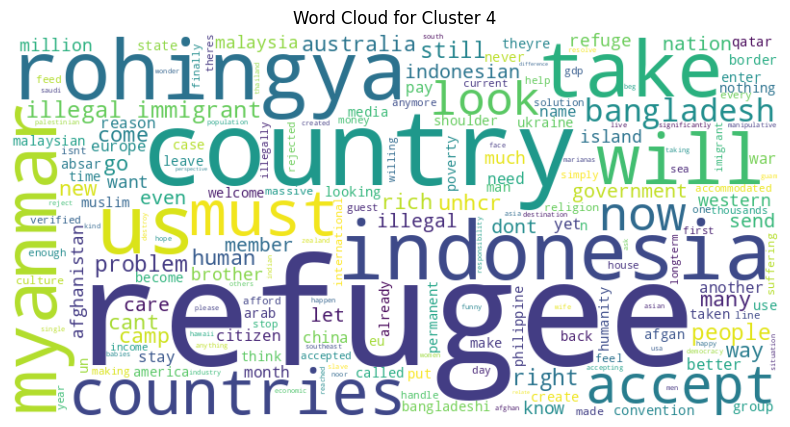

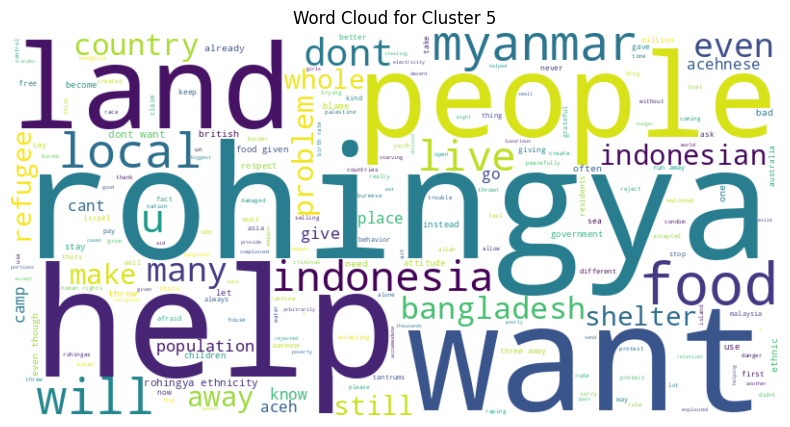

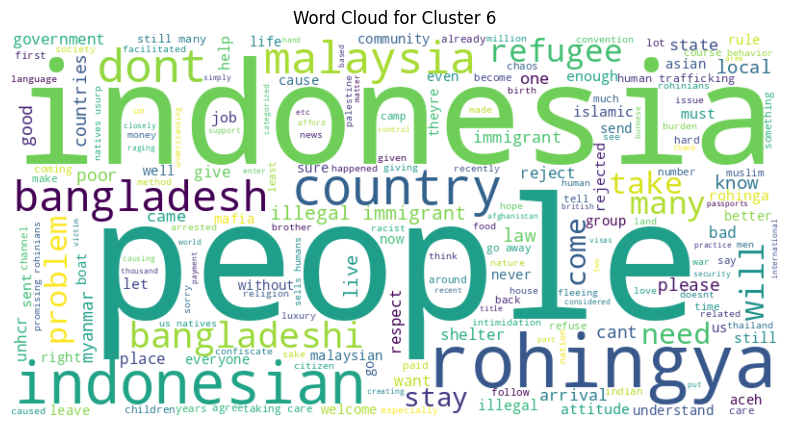

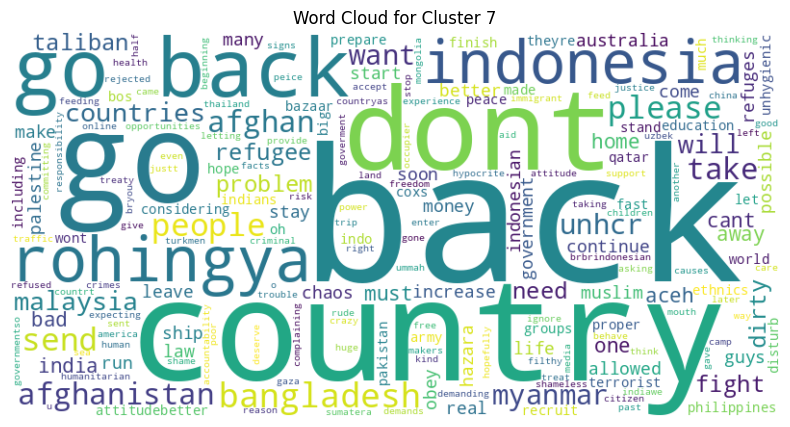

Generating word clouds for Clustering PDM - en_comments_clean.csv...


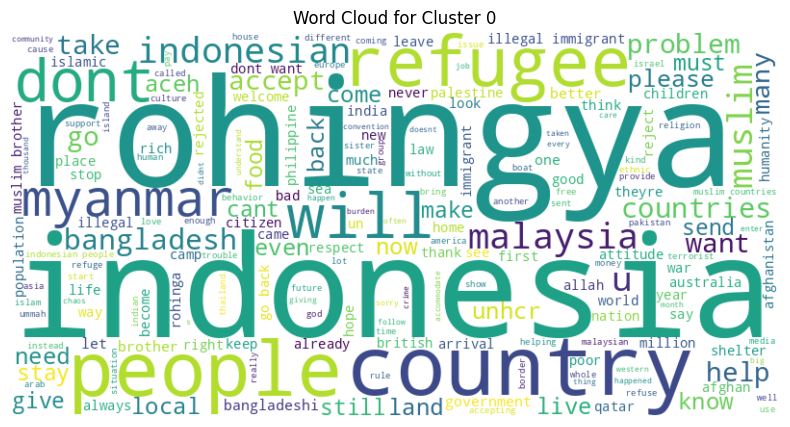

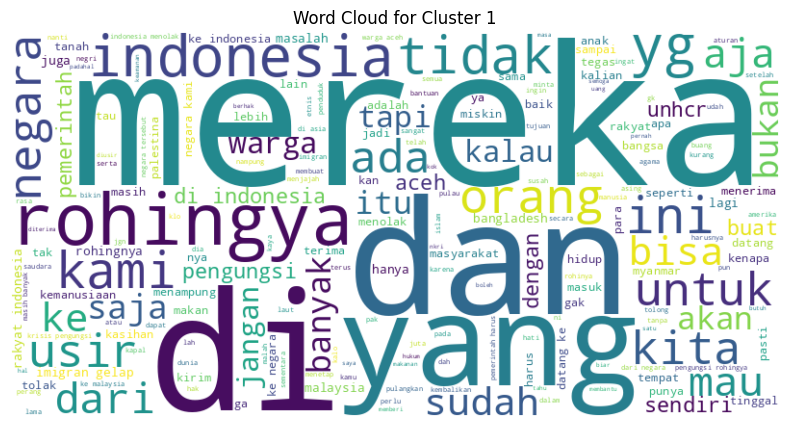

Generating word clouds for Clustering PDM - id_9clusters.csv...


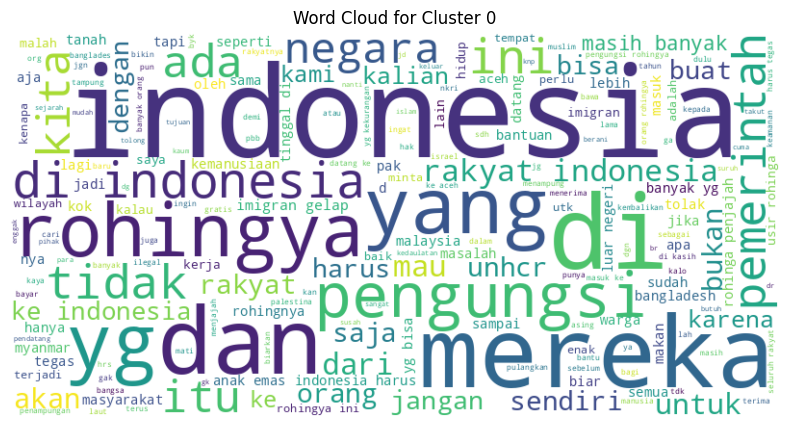

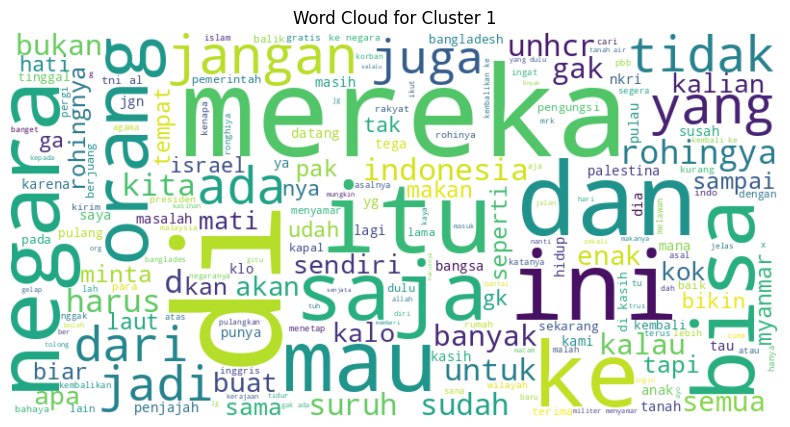

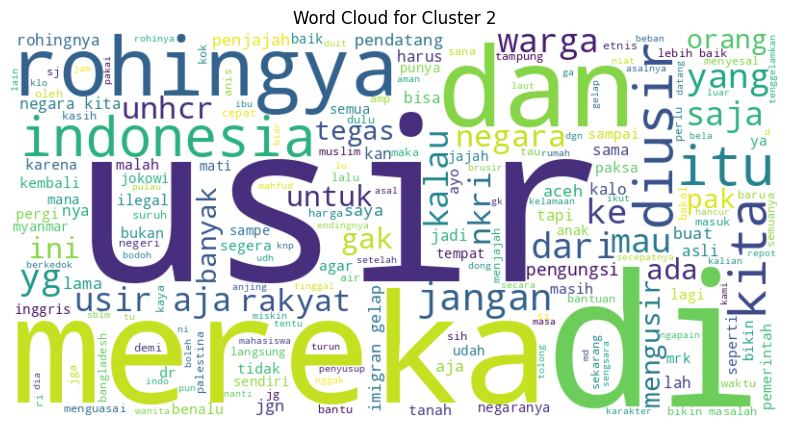

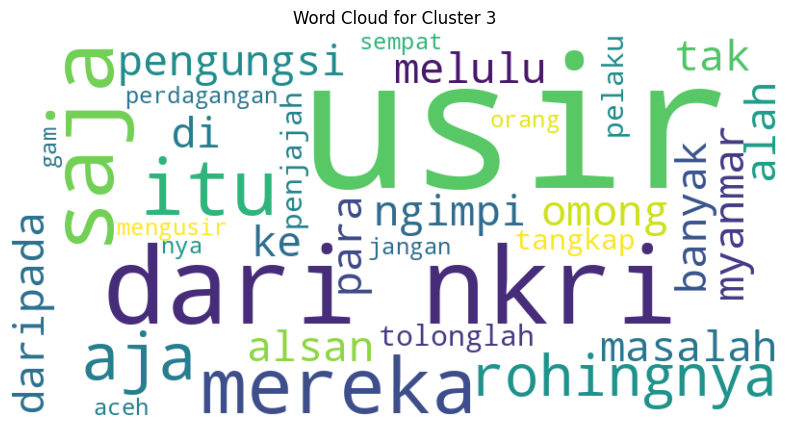

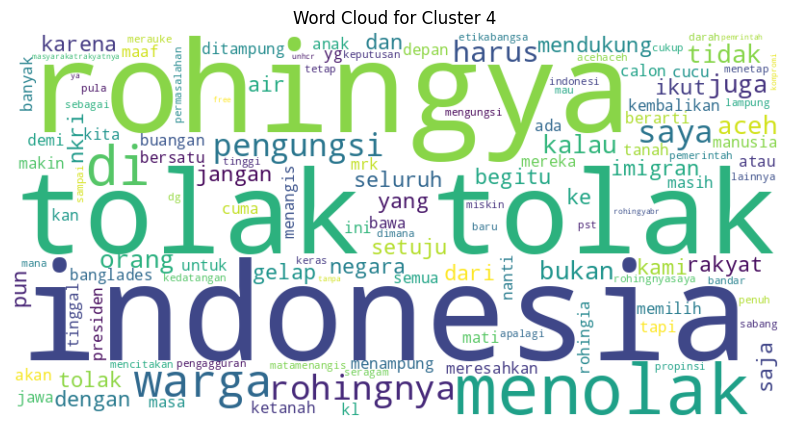

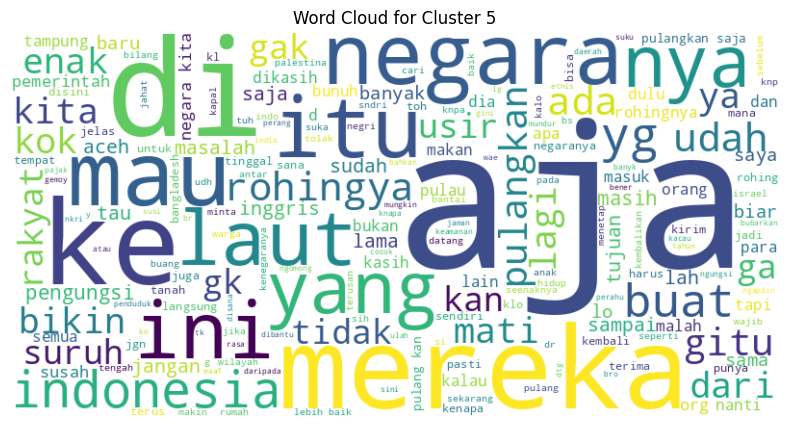

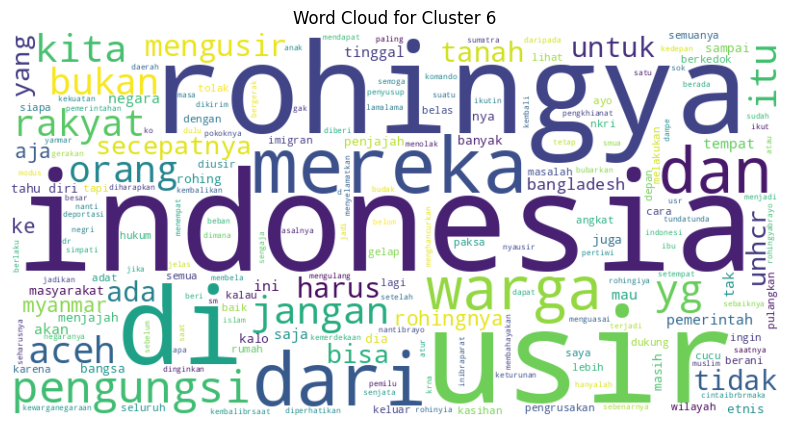

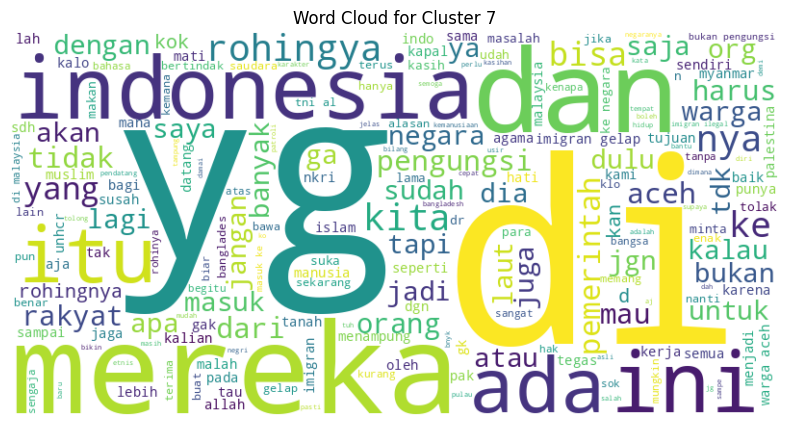

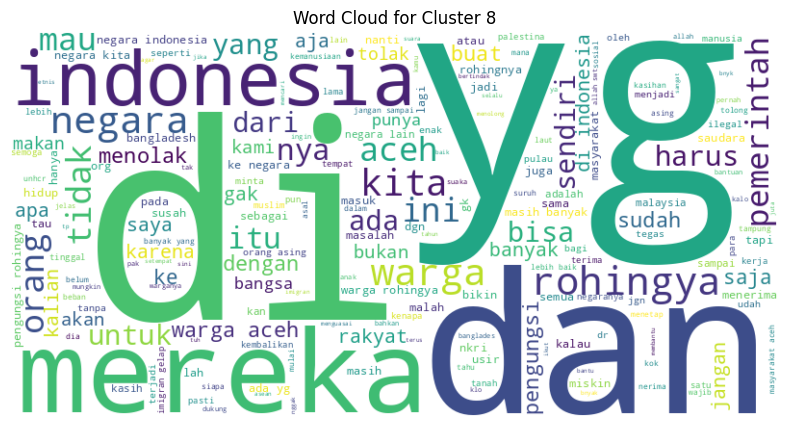

Generating word clouds for Clustering PDM - id_comments_clean.csv...


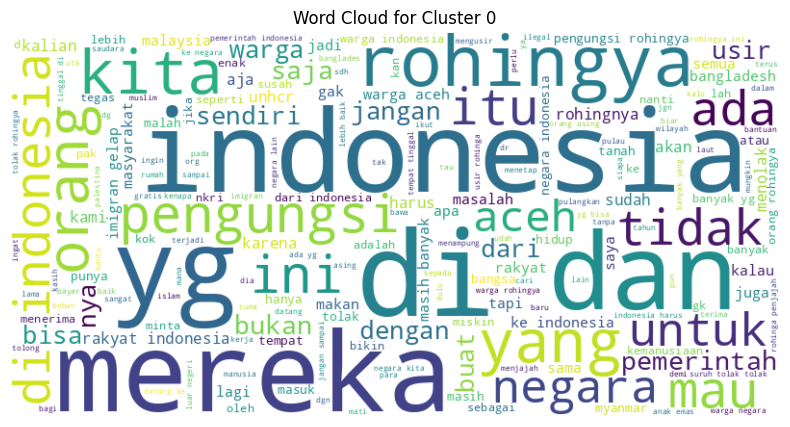

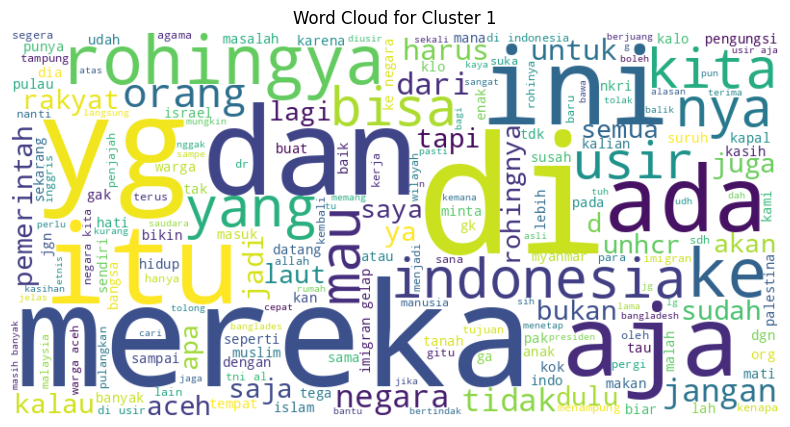

In [ ]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Assuming you have already loaded the CSV files into dataframes
# dataframes is the dictionary containing your dataframes

# Define a function to generate word clouds for each cluster
def generate_wordcloud(df):
    # Convert the 'text' column to strings
    df['text'] = df['text'].astype(str)

    # Group the DataFrame by the cluster column
    grouped = df.groupby('cluster')

    # Generate a word cloud for each cluster
    for cluster, group in grouped:
        text = ' '.join(group['text'])

        # Generate word cloud
        wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)

        # Plot the word cloud
        plt.figure(figsize=(10, 5))
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.axis('off')
        plt.title(f'Word Cloud for Cluster {cluster}')
        plt.show()

# Generate word clouds for each CSV file
for csv_file, df in dataframes.items():
    print(f"Generating word clouds for {csv_file}...")
    generate_wordcloud(df)

#id_comments_clean

In [ ]:
df = pd.read_csv(f'/content/final-project-TDPDM/Clustering PDM - id_comments_clean.csv')
df

,text,cluster
0,budha myanmar teroris,1
1,apa pun itu sejarahnya kuta tidak bole menerim...,1
2,km umat islam carikan solusi rohingnya kl ngom...,1
3,org tdk tau brsukur,1
4,dilihat cara berpakaian sebagian mereka serba ...,1
...,...,...
1761,ditolak saja akal bulus mrk itu nanti klo udh ...,1
1762,lebih baik kembalikan saja ke asal sabab klau ...,1
1763,warga indonesia banyak yang gak bisa makan dan...,0
1764,rakyat indonesia sendiri masih jutaan yg kekur...,0


Generating word clouds for Clustering PDM - en_9clusters.csv...


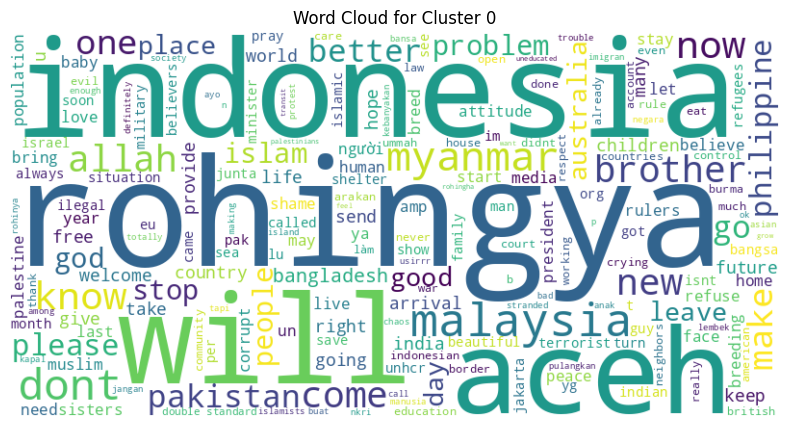

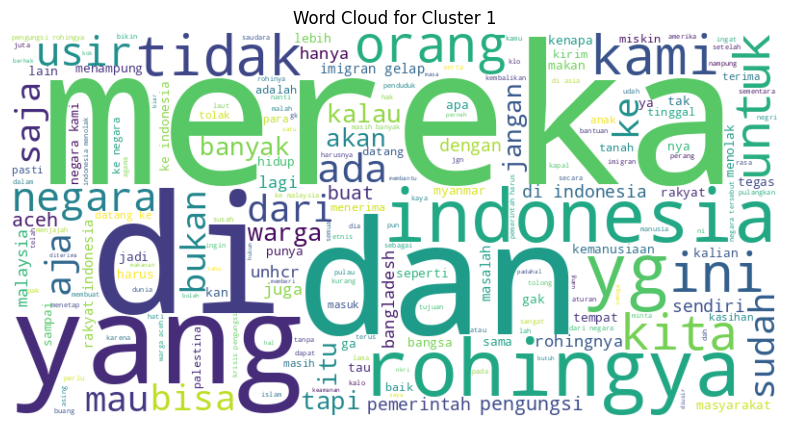

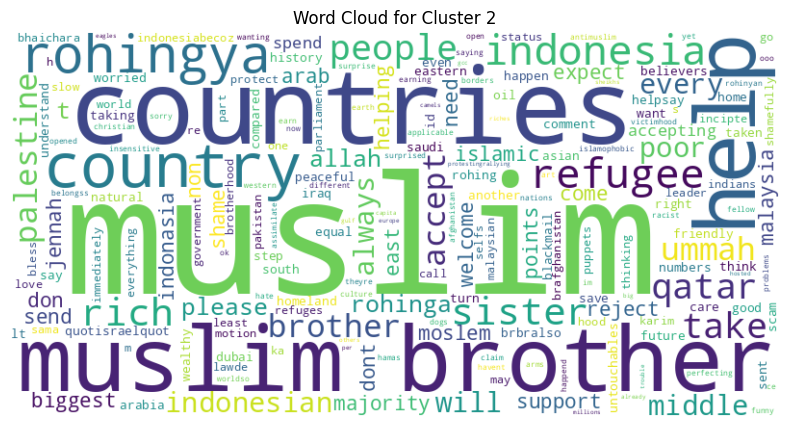

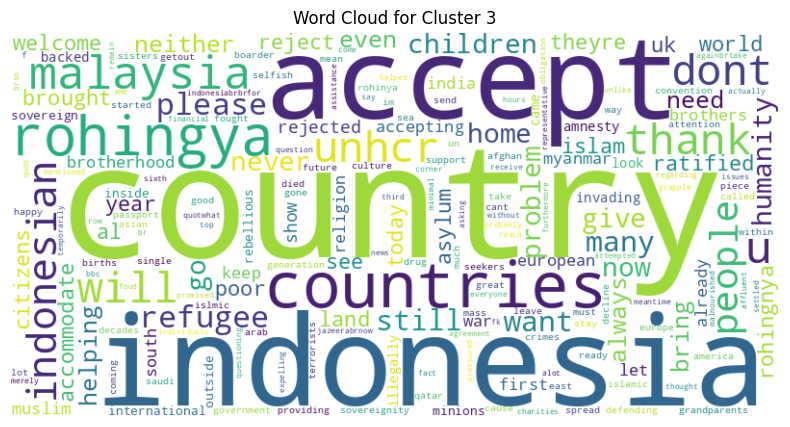

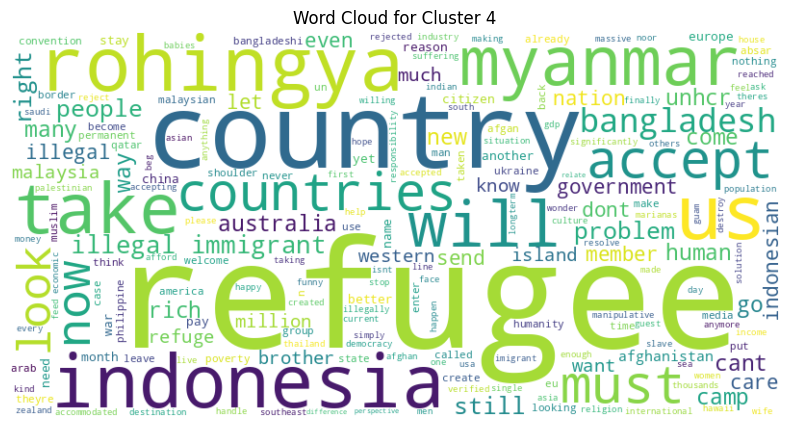

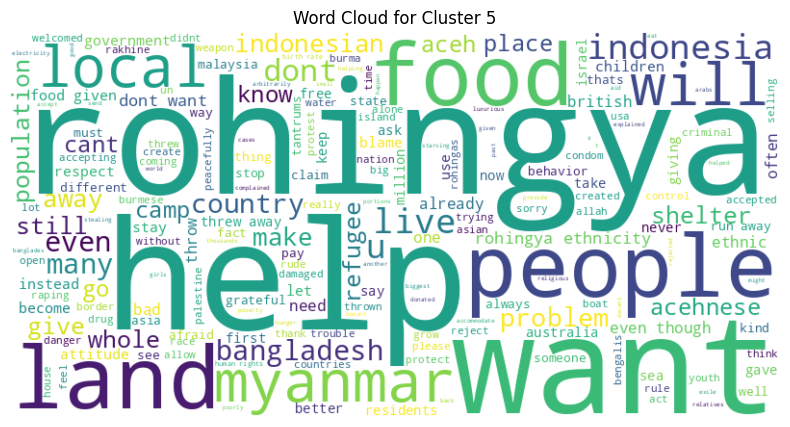

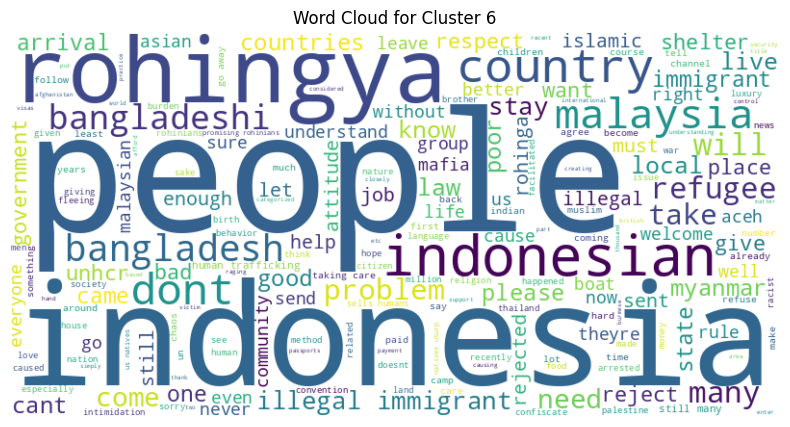

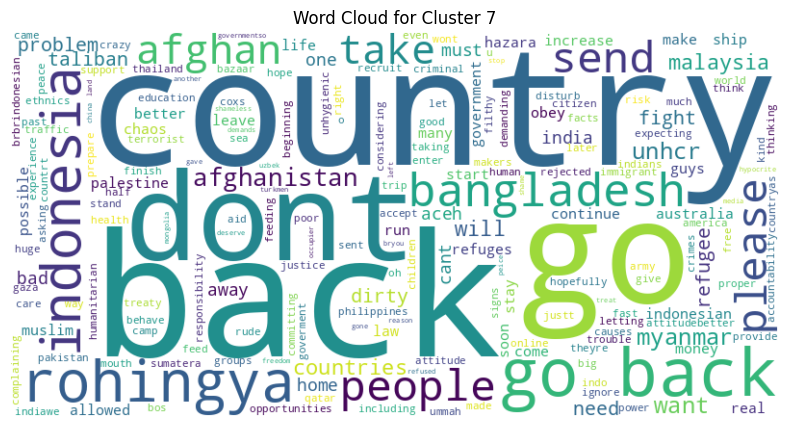

Generating word clouds for Clustering PDM - en_comments_clean.csv...


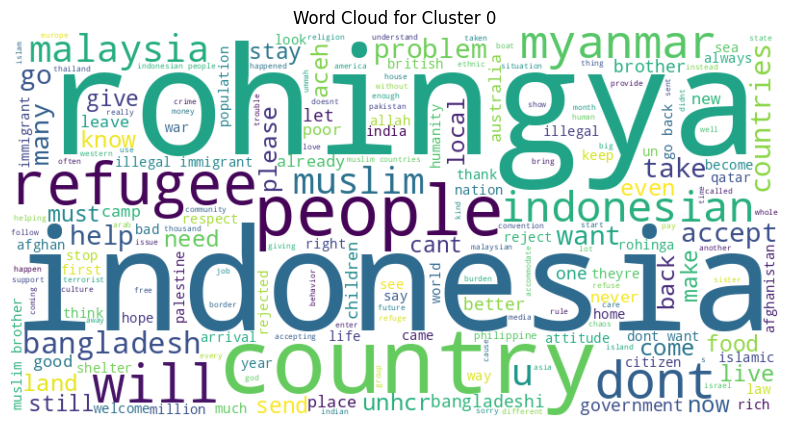

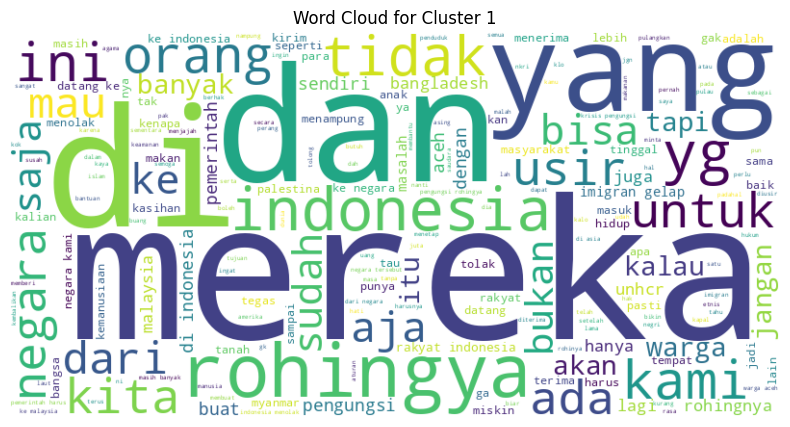

Generating word clouds for Clustering PDM - id_9clusters.csv...


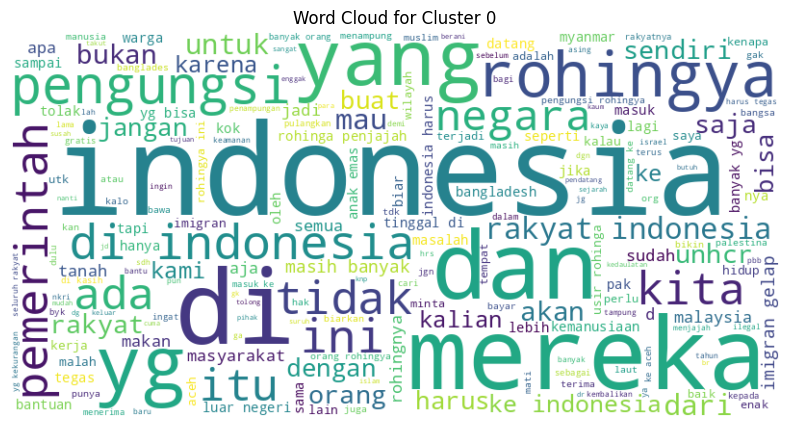

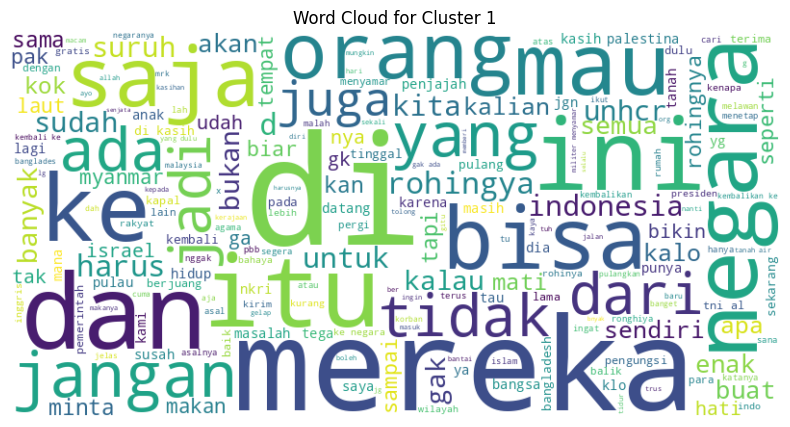

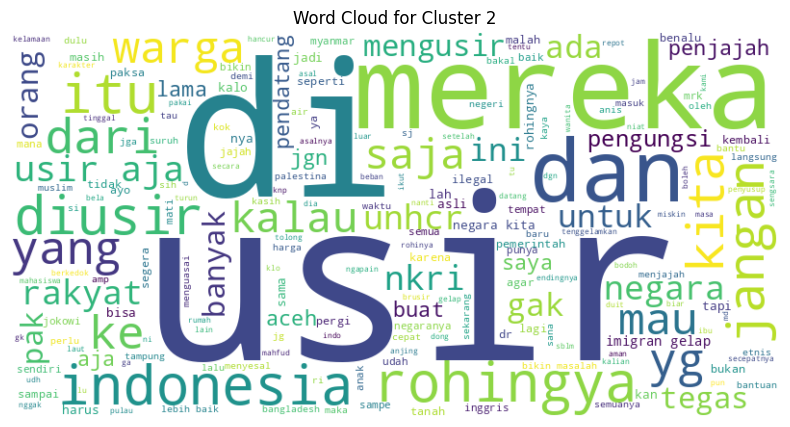

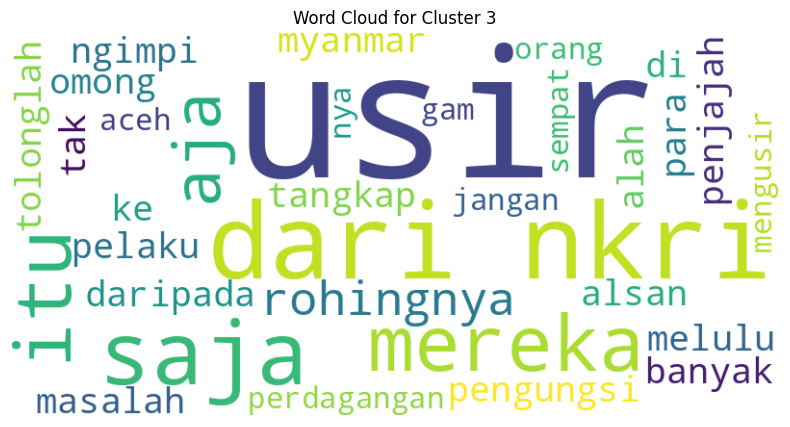

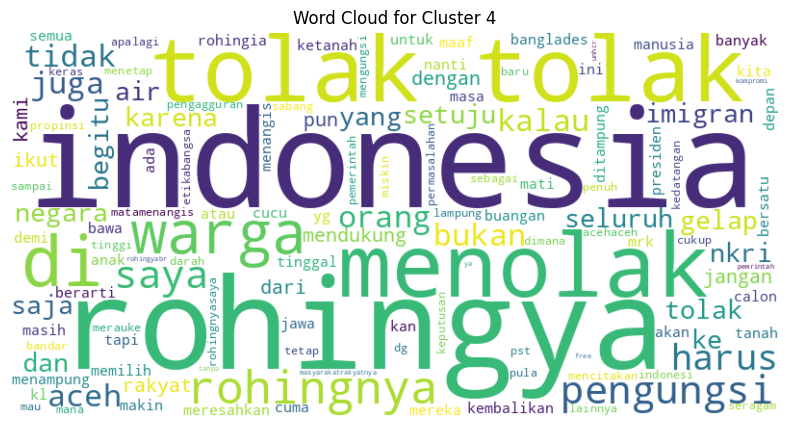

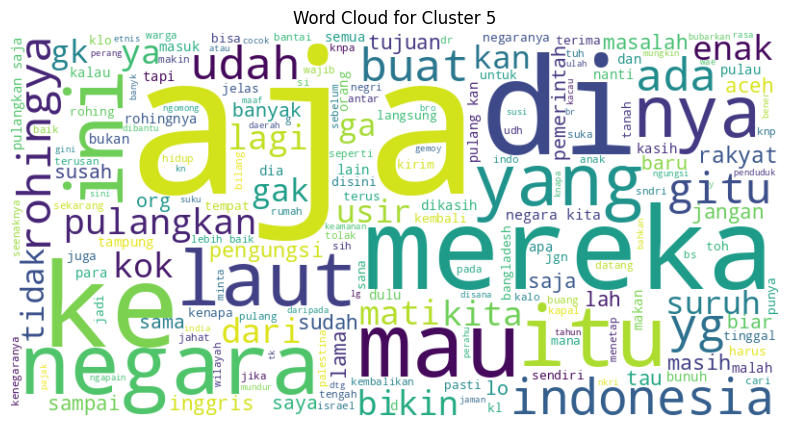

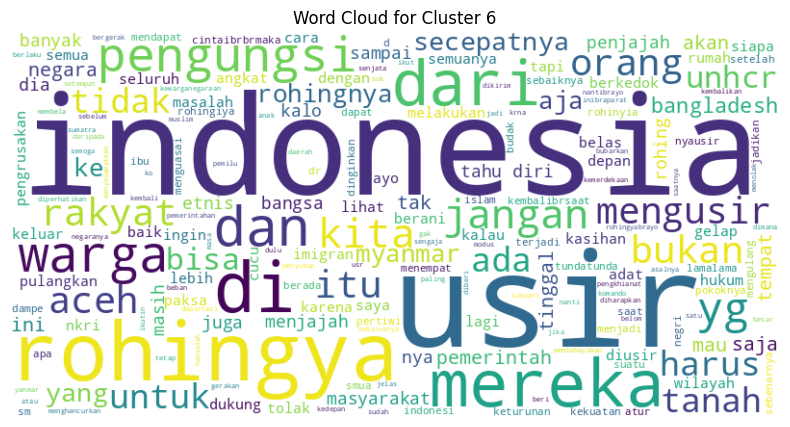

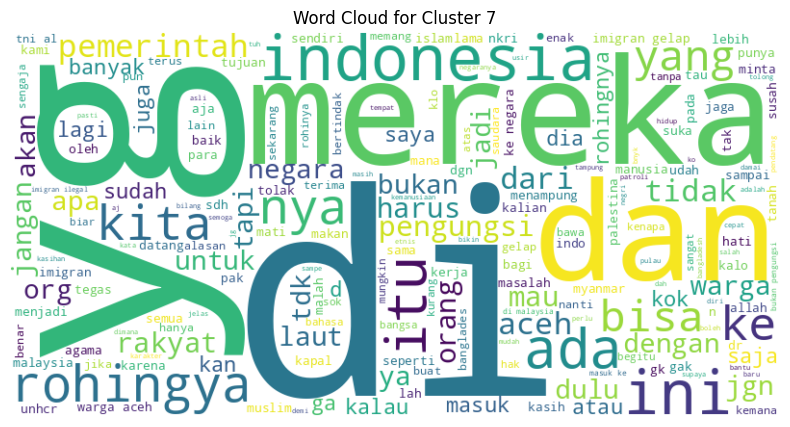

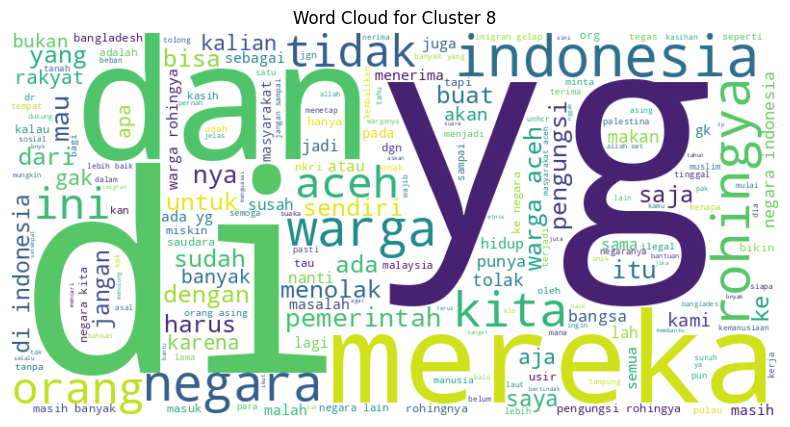

Generating word clouds for Clustering PDM - id_comments_clean.csv...


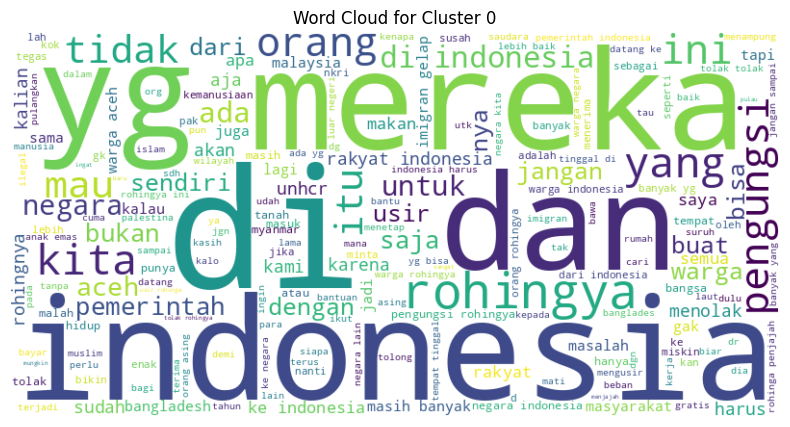

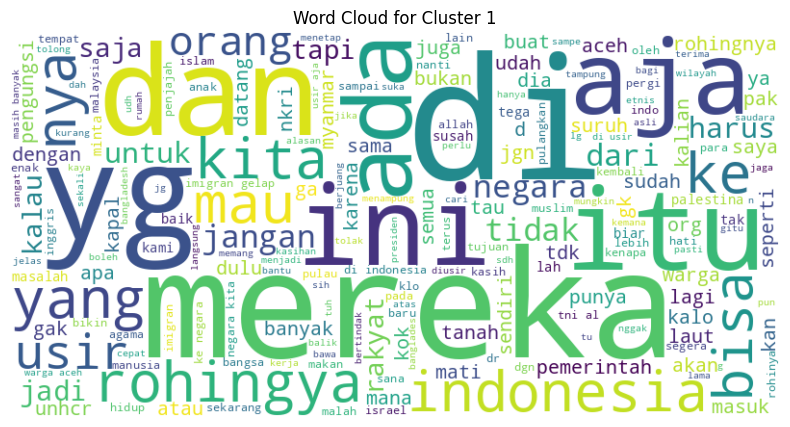

In [ ]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Assuming you have already loaded the CSV files into dataframes
# dataframes is the dictionary containing your dataframes

# Define a function to generate word clouds for each cluster
def generate_wordcloud(df):
    # Convert the 'text' column to strings
    df['text'] = df['text'].astype(str)

    # Group the DataFrame by the cluster column
    grouped = df.groupby('cluster')

    # Generate a word cloud for each cluster
    for cluster, group in grouped:
        text = ' '.join(group['text'])

        # Generate word cloud
        wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)

        # Plot the word cloud
        plt.figure(figsize=(10, 5))
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.axis('off')
        plt.title(f'Word Cloud for Cluster {cluster}')
        plt.show()

# Generate word clouds for each CSV file
for csv_file, df in dataframes.items():
    print(f"Generating word clouds for {csv_file}...")
    generate_wordcloud(df)